In [2]:
import numpy as np
import time, os, sys, random
from urllib.parse import urlparse
import skimage.io
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 75

from urllib.parse import urlparse
import shutil
import pickle
from scipy.optimize import curve_fit
from scipy import stats

from cellpose_omni import models,core

BOLD = '\033[1m'
UNDERLINE = '\033[4m'
END = '\033[0m'

#Check if colab notebook instance has GPU access
if core.use_gpu()==False: 
  #Warnings from the ZeroCost StarDist notebook
  print(BOLD+UNDERLINE+'You do not have GPU access.'+END)
  print('Did you change your runtime ?') 
  print('If the runtime setting is correct then Google did not allocate a GPU for your session')
  print('Expect slow performance. To access GPU try reconnecting later')
  use_GPU=False
else:
  print(BOLD+UNDERLINE+"You have access to the GPU."+END+"\nDetails are:")
  print("*************************************************")
  !nvidia-smi
  use_GPU=True

print("*************************************************")
print("Libraries imported and configured")

2024-04-25 11:42:17,195 [INFO] ** TORCH GPU version installed and working. **
You have access to the GPU.
Details are:
*************************************************
Thu Apr 25 11:42:17 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       On  |   00000000:08:00.0 Off |                    0 |
| N/A   38C    P0             26W /   70W |    4720MiB /  15360

In [3]:
#TESTING FOR 1 POSITION
Input_Directory = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/Pos101/PreprocessedPhase/" #@param {type:"string"}
input_dir = os.path.join(Input_Directory, "") #adds separator to the end regardless if path has it or not

image_format = "tiff" #@param {type:"string"}

save_dir = input_dir+"Masks/"
if not os.path.exists(save_dir):
  os.makedirs(save_dir)
else:
  print("Existing Mask Directory found. Deleting it.")
  shutil.rmtree(save_dir)

files=[]

for r, d, f in os.walk(input_dir):
    for fil in f:
      if (image_format):
        if fil.endswith(image_format):
          files.append(os.path.join(r, fil))
      else:
        files.append(os.path.join(r, fil))
    break #only read the root directory; can change this to include levels
if(len(files)==0):
  print("Number of images loaded: %d." %(len(files)))
  print("Cannot read image files. Check if folder has images")
else:
  print("Number of images loaded: %d." %(len(files)))

Number of images loaded: 121.


No of images loaded are:  121
Example Image:
img_000000016.tiff has 2 dimensions/s
One Channel


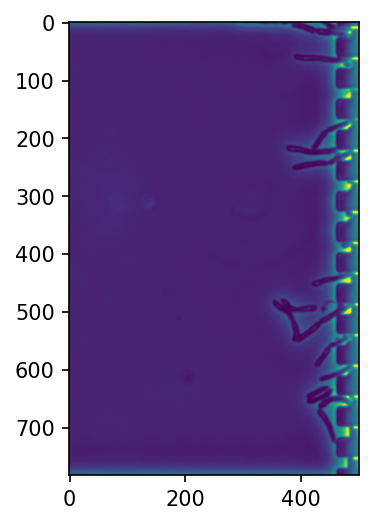

In [4]:
imgs=[] #store all images
files = sorted(files)
#Read images
for f in files:
    im=skimage.io.imread(f)
    n_dim=len(im.shape) #shape of image
    dim=im.shape #dimensions of image
    channel=min(dim) #channel will be dimension with min value usually
    channel_position=dim.index(channel)
    #if no of dim is 3 and channel is first index, swap channel to last index
    if n_dim==3 and channel_position==0: 
        #print(dim)
        im=im.transpose(1,2,0)
        dim=im.shape
    imgs.append(im)
nimg = len(imgs)
print("No of images loaded are: ", nimg)
print("Example Image:")

random_idx = random.choice(range(len(imgs)))
x=imgs[random_idx]
n_dim=len(x.shape)
file_name=os.path.basename(files[random_idx])
print(file_name+" has "+str(n_dim)+" dimensions/s")
if n_dim==3:
    channel_image=x.shape[2]
    fig, axs = plt.subplots(1, channel_image,figsize=(12,5))
    print("Image: %s" %(file_name))
    for channel in range(channel_image):
        axs[channel].imshow(x[:,:,channel])
        axs[channel].set_title('Channel '+str(channel+1),size=5)
        axs[channel].axis('off')       
    fig.tight_layout()
elif n_dim==2:
    print("One Channel")
    plt.imshow(x)
else:
    print("Channel number invalid or dimensions wrong. Image shape is: "+str(x.shape))

In [5]:
Model_Choice = "Bacteria_Omnipose" #@param ["Cytoplasm","Cytoplasm2", "Cytoplasm2_Omnipose", "Bacteria_Omnipose", "Nuclei"]
model_choice=Model_Choice

print("Using model ",model_choice)
Channel_for_segmentation="0" #@param[0,1,2,3]
segment_channel=int(Channel_for_segmentation)

Use_nuclear_channel= False #@param {type:"boolean"}
Nuclear_channel="1" #@param[1,2,3]
nuclear_channel=int(Nuclear_channel)

omni= True #@param {type:"boolean"}

Diameter =  0 #@param {type:"number"}
diameter=Diameter

if model_choice=="Cytoplasm":
    model_type="cyto"

elif model_choice=="Cytoplasm2":
    model_type="cyto2"

elif model_choice=="Cytoplasm2_Omnipose":
    model_type="cyto2_omni"

elif model_choice=="Bacteria_Omnipose":
    model_type="bact_omni" 
    diameter = 0

elif model_choice=="Nuclei":
    model_type="nuclei" 


# channels = [cytoplasm, nucleus]
if model_choice not in "Nucleus":
    if Use_nuclear_channel:
        channels=[segment_channel,nuclear_channel]
    else:
        channels=[segment_channel,0]
else: #nucleus
    channels=[segment_channel,0]

# DEFINE CELLPOSE MODEL
model_path = '/home/bmtran/.cellpose/models/Praneeth/model3'
model = models.CellposeModel(gpu=use_GPU, pretrained_model=model_path,
                             model_type=None, net_avg=True, use_torch=True,
                             diam_mean=30., device=None,
                             residual_on=True, style_on=True, concatenation=False,
                             nchan=1, nclasses=3, dim=2, omni = omni,
                             checkpoint=False, dropout=False, kernel_size=2)
if diameter == 0:
    diameter = None
    print("Diameter is set to None. The size of the cells will be estimated on a per image basis")

Using model  Bacteria_Omnipose
2024-02-07 15:36:43,612 [INFO] ** TORCH GPU version installed and working. **
2024-02-07 15:36:43,613 [INFO] >>>> using GPU
Diameter is set to None. The size of the cells will be estimated on a per image basis


Image: img_000000120


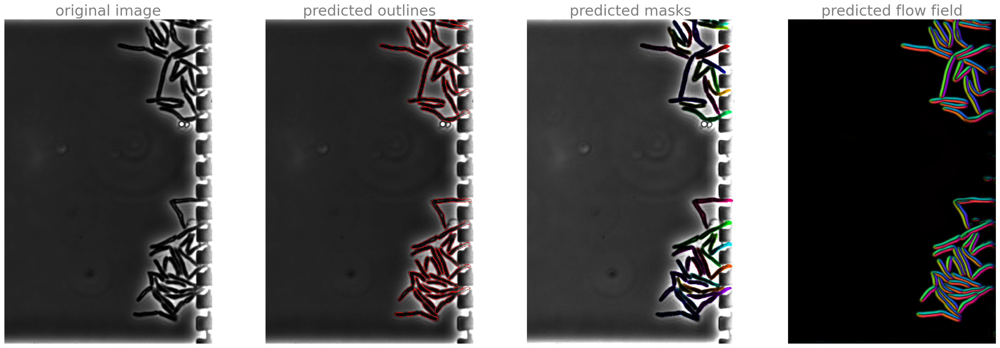

In [6]:
from skimage.util import img_as_ubyte

Image_Number =  121#@param {type:"number"}
Image_Number-=1 #indexing starts at zero
Diameter = 40 #@param {type:"number"}
Flow_Threshold = 0.8 #@param {type:"slider", min:0.1, max:1.1, step:0.1}
flow_threshold=Flow_Threshold
Cell_Probability_Threshold= 0 #@param {type:"slider", min:-6, max:6, step:1}
cellprob_threshold=Cell_Probability_Threshold

diameter=Diameter
if diameter == 0:
  diameter = None
if Image_Number == -1:
  Image_Number=0
try:
    image = imgs[Image_Number]
except IndexError as i:
   print("Image number does not exist",i)
   print("Actual no of images in folder: ",len(imgs))
print("Image: %s" %(os.path.splitext(os.path.basename(files[Image_Number]))[0]))
img1=imgs[Image_Number]

import cv2
masks, flows, styles = model.eval(img1, diameter=diameter, flow_threshold=flow_threshold, channels=None, 
                                         omni=omni, min_size=250, mask_threshold=0, cluster=True, affinity_seg=True, bsize=256, num_workers=16)
# DISPLAY RESULTS
from cellpose_omni import plot
maski = masks
flowi = flows[0]
#convert to 8-bit if not so it can display properly in the graph
if img1.dtype!='uint8':
  img1=img_as_ubyte(img1)
fig = plt.figure(figsize=(24,8))
plot.show_segmentation(fig, img1, maski, flowi, channels=channels)
plt.tight_layout()
plt.show()

Analysing multiple positions of Msm WT (REF)

Running segmentation on channel 0
Using the model:  Bacteria_Omnipose
Cellpose will use a diameter of 40
Using a flow threshold of: 0.8 and a cell probability threshold of: 0
/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/Pos101/PreprocessedPhase
No of images loaded are:  121

Segmenting:  img_000000000

Segmenting:  img_000000001

Segmenting:  img_000000002

Segmenting:  img_000000003

Segmenting:  img_000000004

Segmenting:  img_000000005

Segmenting:  img_000000006

Segmenting:  img_000000007

Segmenting:  img_000000008

Segmenting:  img_000000009

Segmenting:  img_000000010

Segmenting:  img_000000011

Segmenting:  img_000000012

Segmenting:  img_000000013

Segmenting:  img_000000014

Segmenting:  img_000000015

Segmenting:  img_000000016

Segmenting:  img_000000017

Segmenting:  img_000000018

Segmenting:  img_000000019

Segmenting:  img_000000020

Segmenting:  img_000000021

Segmenting:  img_000000022

Segmenting:  img_000000023

Segmenting:  img_00000

/scratch/8583414/ipykernel_44135/1197614651.py:165: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(facecolor='white')


/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/Pos112/PreprocessedPhase
No of images loaded are:  121

Segmenting:  img_000000000

Segmenting:  img_000000001

Segmenting:  img_000000002

Segmenting:  img_000000003

Segmenting:  img_000000004

Segmenting:  img_000000005

Segmenting:  img_000000006

Segmenting:  img_000000007

Segmenting:  img_000000008

Segmenting:  img_000000009

Segmenting:  img_000000010

Segmenting:  img_000000011

Segmenting:  img_000000012

Segmenting:  img_000000013

Segmenting:  img_000000014

Segmenting:  img_000000015

Segmenting:  img_000000016

Segmenting:  img_000000017

Segmenting:  img_000000018

Segmenting:  img_000000019

Segmenting:  img_000000020

Segmenting:  img_000000021

Segmenting:  img_000000022

Segmenting:  img_000000023

Segmenting:  img_000000024

Segmenting:  img_000000025

Segmenting:  img_000000026

Segmenting:  img_000000027

Segmenting:  img_000000028

Segmenting:  img_000000029

Segmenting:  img_000000030

S

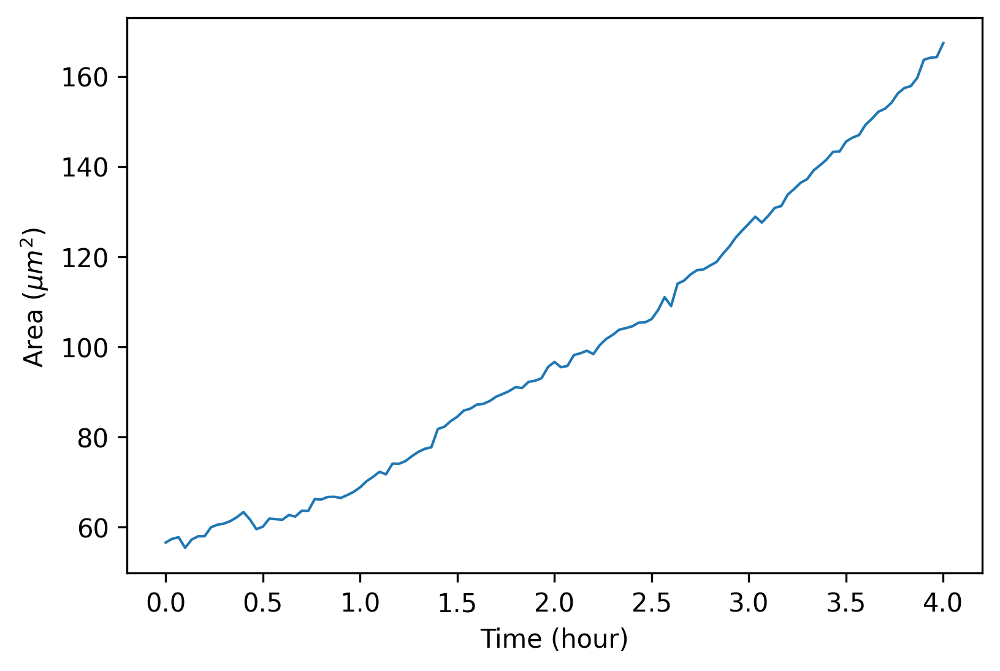

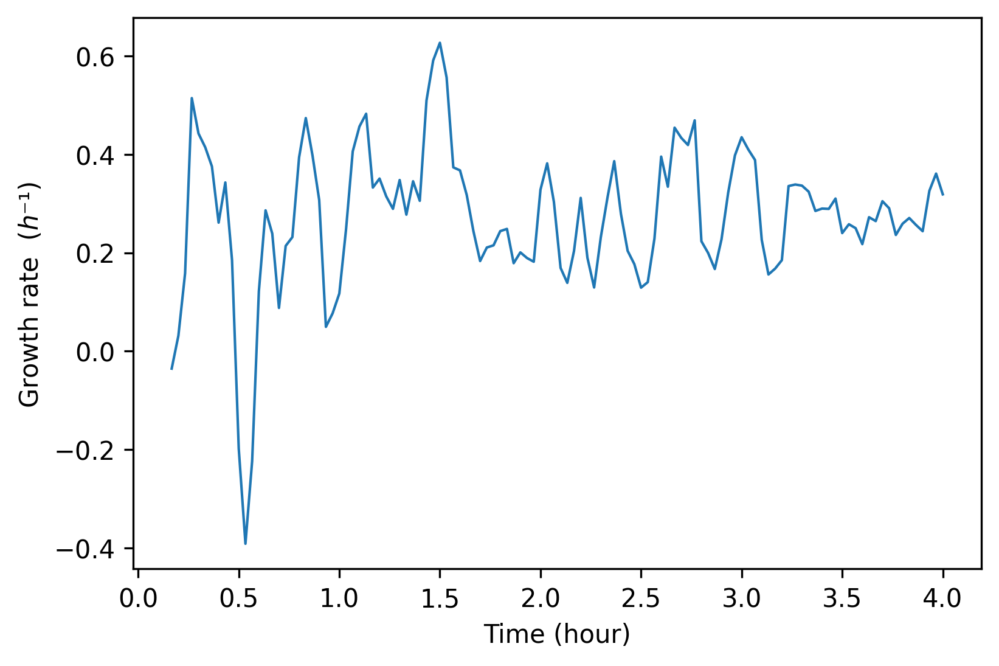

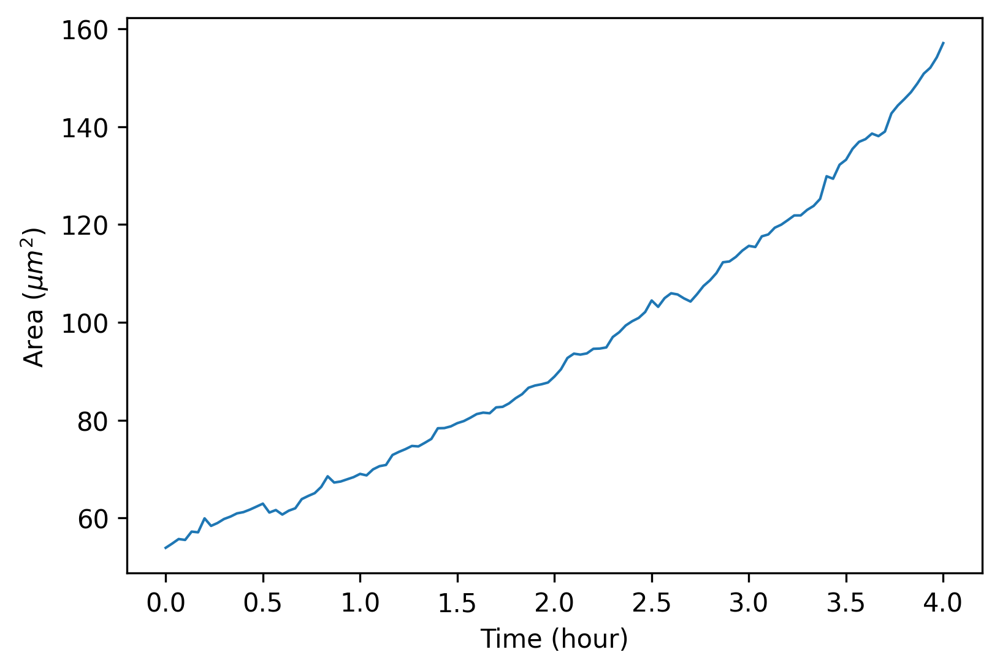

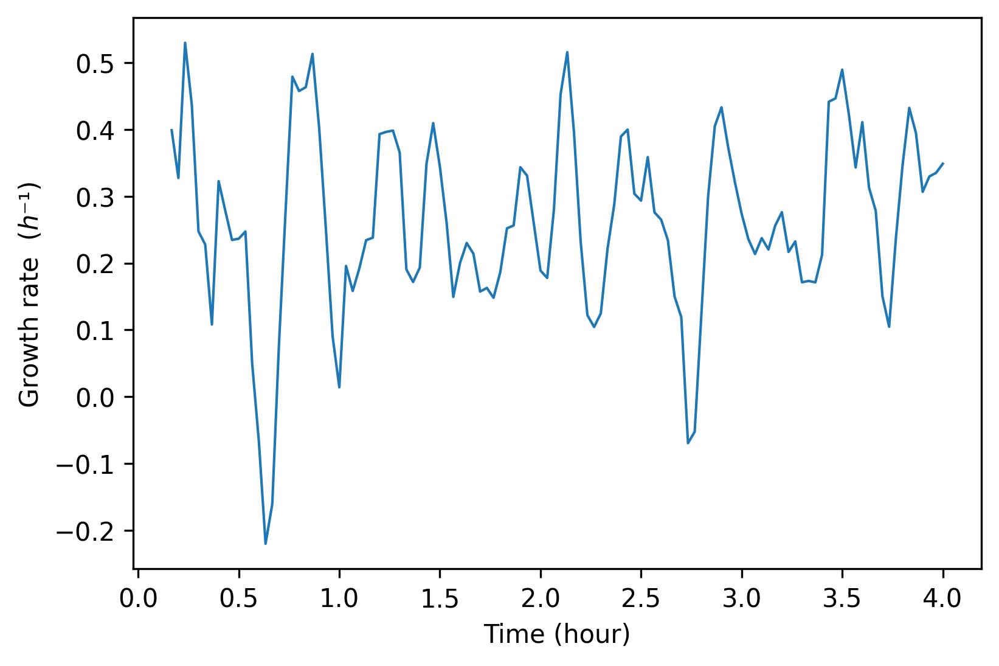

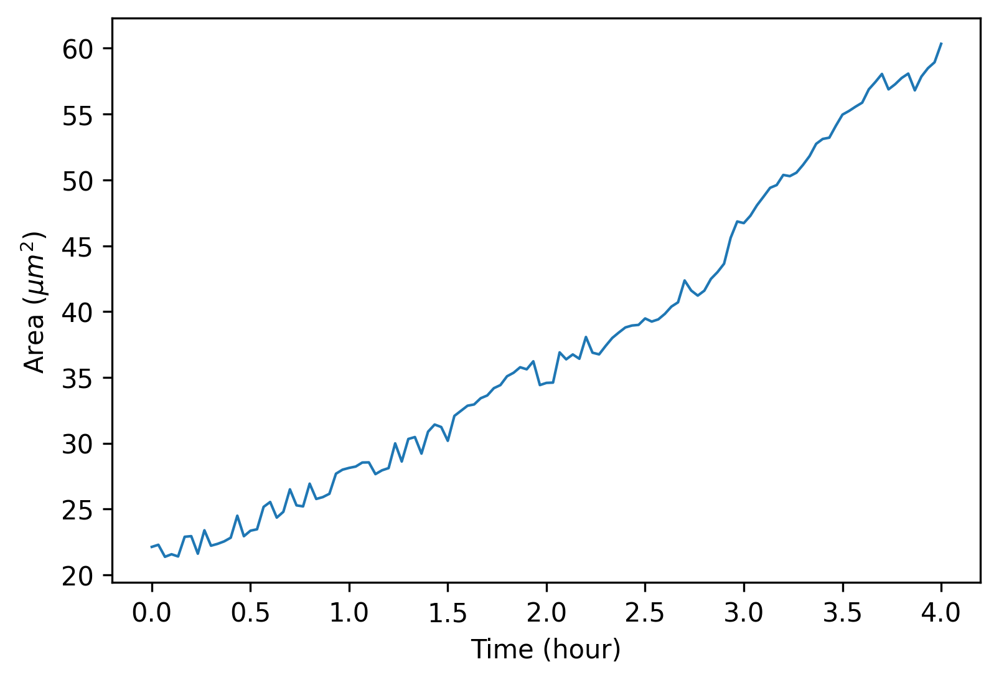

...

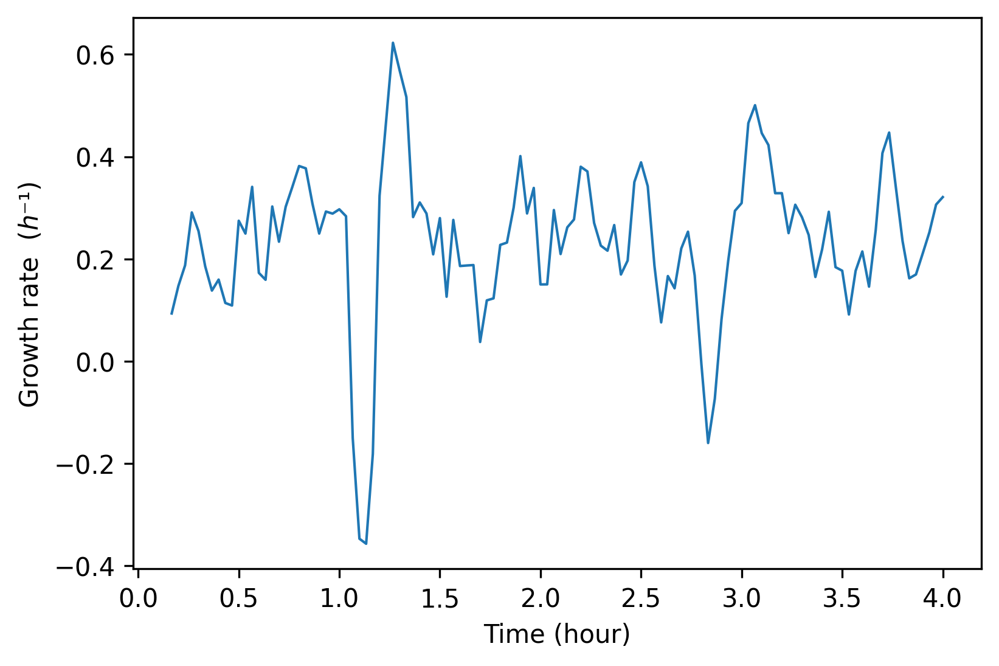

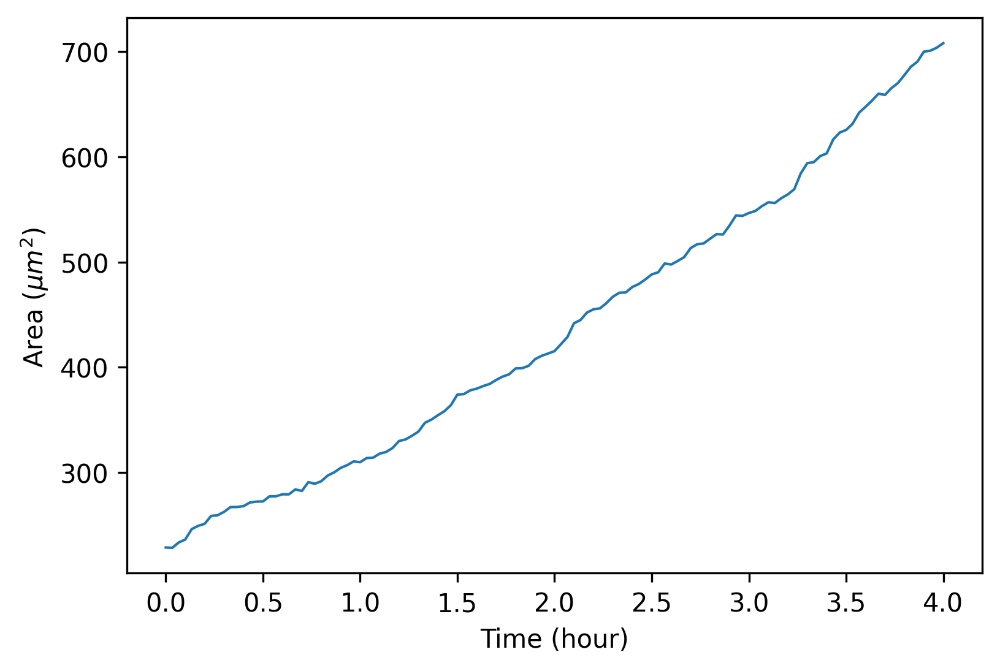

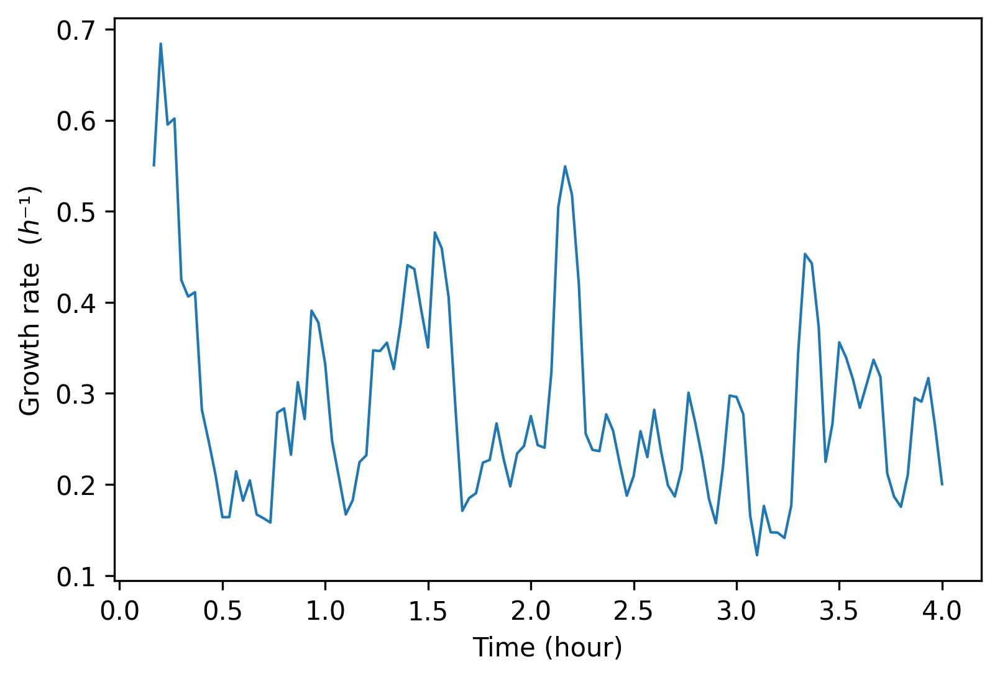

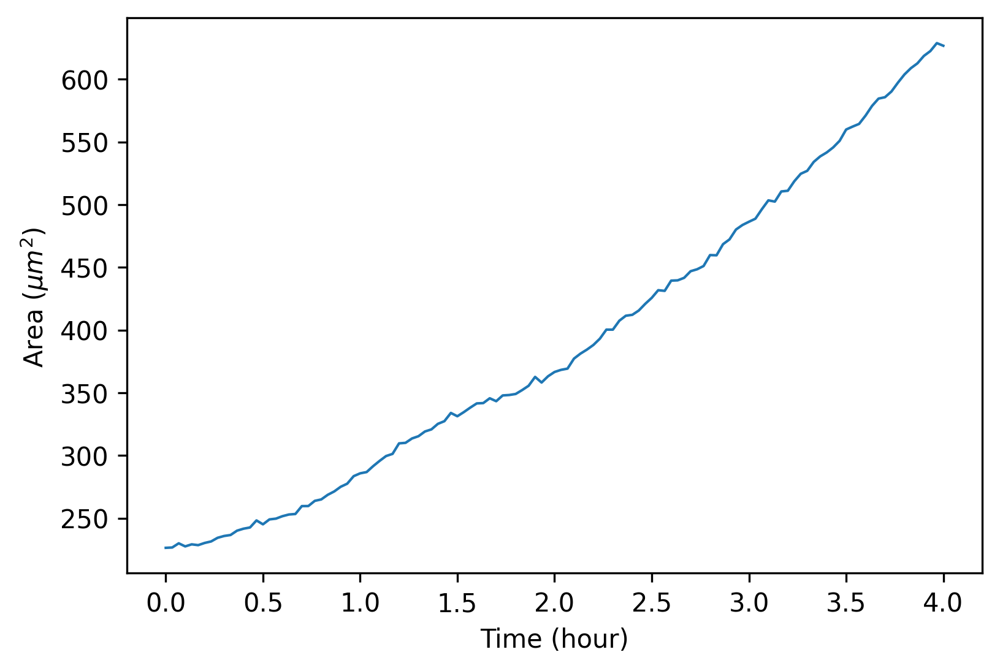

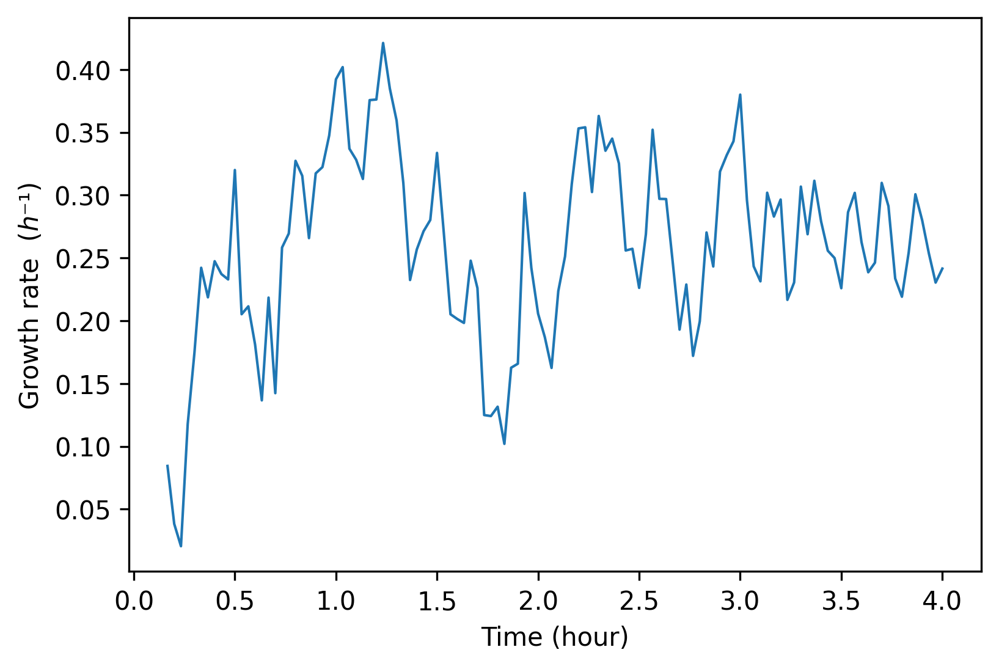

In [8]:
Save_Flow= False #@param {type:"boolean"}
save_flow=Save_Flow

print("Running segmentation on channel %s" %(segment_channel))
print("Using the model: ",model_choice)
if diameter is None:
  print("Diameter will be estimated from the image/s")
else:
  print(f"Cellpose will use a diameter of {diameter}")
print(f"Using a flow threshold of: {flow_threshold} and a cell probability threshold of: {cellprob_threshold}")

main_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/" #@param {type:"string"}
positions = list(range(101,132))
list_position_dirs = []

for position in positions:
    if position < 100:
        dir_string = 'Pos0' + str(position)
    else:
        dir_string = 'Pos' + str(position)
    
    directory = os.path.join(main_dir, dir_string)
    list_position_dirs.append(directory)

phase_dir_name = 'PreprocessedPhase'
for position_directory in list_position_dirs:
    folder_list = os.listdir(position_directory)
    
    for folder_name in folder_list:
        if folder_name == phase_dir_name:
            input_dir = os.path.join(position_directory,folder_name)
            print(input_dir)
            
            save_dir = input_dir+"Masks/"
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            else:
                print("Existing Mask Directory found. Deleting it.")
                shutil.rmtree(save_dir)
            
            # r=root, d=directories, f = files
            files=[]
            for r, d, f in os.walk(input_dir):
                for fil in f:
                    if (image_format):
                        if fil.endswith(image_format):
                            files.append(os.path.join(r, fil))
                    else:
                        files.append(os.path.join(r, fil))
                break #only read the root directory; can change this to include levels
            
            imgs=[] #store all images
            files = sorted(files)
            #print(files)
            #Read images
            for f in files:
                im=skimage.io.imread(f)
                n_dim=len(im.shape) #shape of image
                dim=im.shape #dimensions of image
                channel=min(dim) #channel will be dimension with min value usually
                channel_position=dim.index(channel)
                #if no of dim is 3 and channel is first index, swap channel to last index
                if n_dim==3 and channel_position==0: 
                    #print(dim)
                    im=im.transpose(1,2,0)
                    dim=im.shape
                imgs.append(im)

            nimg = len(imgs)
            print("No of images loaded are: ", nimg)

            if (not os.path.exists(save_dir)):
                os.mkdir(save_dir)

            if save_flow:
                print("Saving Flow")
                flows_save_dir=save_dir+"flows"+os.sep
                print("Save Directory for flows is: ",flows_save_dir)
                if (not os.path.exists(flows_save_dir)):
                    os.mkdir(flows_save_dir)
            ##########################################################################
            pos_areas = np.zeros(len(imgs))
            #print(len(pos_areas))
            ##########################################################################
            for img_idx, img in enumerate(imgs):
                file_name=os.path.splitext(os.path.basename(files[img_idx]))[0]
                print("\nSegmenting: ",file_name)
                mask, flow, style = model.eval(img, diameter=diameter, flow_threshold=flow_threshold, channels=None,
                                         omni=omni, min_size=250, mask_threshold=0, cluster=True, affinity_seg=True, bsize=256, num_workers=16)
            ##########################################################################
                #get area value of the masks
                npoints = np.unique(mask, return_counts=True)[1][1:] #area in pixel numbers
                pos_areas[img_idx] = sum(npoints)
            ##########################################################################    
                #Output name for masks
                mask_output_name=save_dir+"MASK_"+file_name+".tif"
                #Save mask as 16-bit in case this has to be used for detecting than 255 objects
                mask=mask.astype(np.uint16)
                #Save flow as 8-bit
                skimage.io.imsave(mask_output_name,mask, check_contrast=False)
                if save_flow:
                  #Output name for flows
                  flow_output_name=flows_save_dir+"FLOWS_"+file_name+".tif"
                  #Save as 8-bit
                  flow_image=flow[0].astype(np.uint8)
                  skimage.io.imsave(flow_output_name,flow_image, check_contrast=False)
            
            #Save parameters used in Cellpose
            parameters_file=save_dir+"Cellpose_parameters_used.txt" 
            outFile=open(parameters_file, "w") 
            outFile.write("CELLPOSE PARAMETERS\n") 
            outFile.write("Model: "+model_choice+"\n") 
            if diameter == 0:
                diameter = "Automatically estimated by cellpose"
            outFile.write("Omni Flag: "+str(omni)+"\n") 
            outFile.write("Diameter: "+str(diameter)+"\n") 
            outFile.write("Flow Threshold: "+str(flow_threshold)+"\n") 
            outFile.write("Cell probability Threshold: "+str(cellprob_threshold)+"\n") 
            outFile.close() 
            #Write our areas data for each position
            with open(os.path.join(save_dir,"growth_areas.pickle"), "wb") as file:
                pickle.dump(pos_areas, file)

Collecting area growth and growth rate data for plotting of Msm WT (REF)

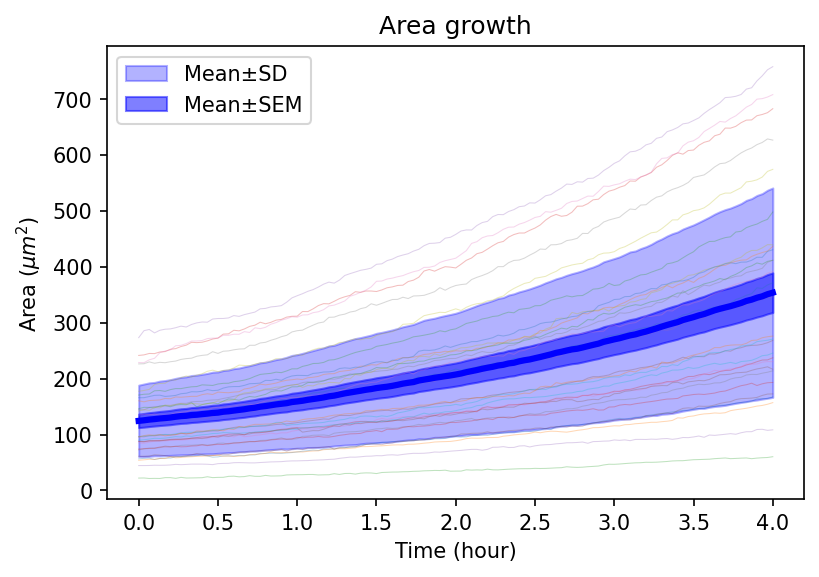

In [7]:
main_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/" #@param {type:"string"}
all_positions = list(range(101,132))
empty_positions = [112,113,118]
positions = [pos for pos in all_positions if pos not in empty_positions]

list_position_dirs = []

for position in positions:
    if position < 100:
        dir_string = 'Pos0' + str(position)
    else:
        dir_string = 'Pos' + str(position)
    
    directory = os.path.join(main_dir, dir_string)
    list_position_dirs.append(directory)

phase_dir_name = 'PreprocessedPhaseMasks'
merged_areas_growth_data = []
merged_growth_rate_data = []

for position_directory in list_position_dirs:
    folder_list = os.listdir(position_directory)
    
    for folder_name in folder_list:
        if folder_name == phase_dir_name:
            input_dir = os.path.join(position_directory,folder_name)
            #print(input_dir)
            file_list = os.listdir(input_dir)
            
            for file_name in file_list:
                if file_name.endswith('growth_areas.pickle'):
                    areas_file_path = os.path.join(input_dir, file_name)

                    with open(areas_file_path, 'rb') as f:
                        areas_growth_data = pickle.load(f)

                        merged_areas_growth_data.append(areas_growth_data)

                if file_name.endswith('growth_rate.pickle'):
                    growth_rate_file_path = os.path.join(input_dir, file_name)

                    with open(growth_rate_file_path, 'rb') as f:
                        growth_rate_data = pickle.load(f)

                        merged_growth_rate_data.append(growth_rate_data)

#Stack merged area growth to calculate mean, standard deviation and standard error of mean
stacked_merged_areas_growth_data = np.vstack(merged_areas_growth_data)

with open(os.path.join(main_dir,"stacked_merged_areas_growth_data.pickle"), "wb") as file:
    pickle.dump(stacked_merged_areas_growth_data, file)
        
areas_column_means = np.mean(stacked_merged_areas_growth_data, axis=0)
areas_column_std_dev = np.std(stacked_merged_areas_growth_data, axis=0, ddof=1)
areas_column_std_err = stats.sem(stacked_merged_areas_growth_data, axis=0, ddof=1)

#Extract the number of positions and of frames
num_pos, num_frame = stacked_merged_areas_growth_data.shape

time_plot = [time*(2/60) for time in range(0, num_frame)] #the interval time between two frames is 2 min,
corrected_areas_plot = stacked_merged_areas_growth_data*(0.0733**2) #the pixel size is 73.3 nm at 150x magnification in Nikon6
corrected_areas_column_means = areas_column_means*(0.0733**2)
corrected_areas_column_std_dev = areas_column_std_dev*(0.0733**2)
corrected_areas_column_std_err = areas_column_std_err*(0.0733**2)

# Create a plot
plt.figure(facecolor='white')  # Optional: Set the figure size
plt.plot(time_plot, corrected_areas_plot.T, lw = 0.5, alpha=0.3)  # Transpose the data to plot columns as separate lines
plt.plot(time_plot, corrected_areas_column_means, lw = 3, color = 'blue')
plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_dev, 
                 corrected_areas_column_means + corrected_areas_column_std_dev, 
                 label='Mean±SD', alpha=0.3, color = 'blue')
plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_err, 
                 corrected_areas_column_means + corrected_areas_column_std_err, 
                 label='Mean±SEM', alpha=0.5, color = 'blue')
plt.xlabel('Time (hour)')
plt.ylabel('Area'+ r' ($\mu m^2$) ')
plt.title('Area growth')
plt.legend()
plt.show()

Analysing multiple positions of Msm NCTC8159 WT (RIF10)

Running segmentation on channel 0
Using the model:  Bacteria_Omnipose
Cellpose will use a diameter of 40
Using a flow threshold of: 0.8 and a cell probability threshold of: 0
/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/RIF10/Pos201/PreprocessedPhase
No of images loaded are:  121

Segmenting:  img_000000000

Segmenting:  img_000000001

Segmenting:  img_000000002

Segmenting:  img_000000003

Segmenting:  img_000000004

Segmenting:  img_000000005

Segmenting:  img_000000006

Segmenting:  img_000000007

Segmenting:  img_000000008

Segmenting:  img_000000009

Segmenting:  img_000000010

Segmenting:  img_000000011

Segmenting:  img_000000012

Segmenting:  img_000000013

Segmenting:  img_000000014

Segmenting:  img_000000015

Segmenting:  img_000000016

Segmenting:  img_000000017

Segmenting:  img_000000018

Segmenting:  img_000000019

Segmenting:  img_000000020

Segmenting:  img_000000021

Segmenting:  img_000000022

Segmenting:  img_000000023

Segmenting:  img_000

/scratch/8583414/ipykernel_44135/2355206235.py:165: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(facecolor='white')


/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/RIF10/Pos212/PreprocessedPhase
No of images loaded are:  121

Segmenting:  img_000000000

Segmenting:  img_000000001

Segmenting:  img_000000002

Segmenting:  img_000000003

Segmenting:  img_000000004

Segmenting:  img_000000005

Segmenting:  img_000000006

Segmenting:  img_000000007

Segmenting:  img_000000008

Segmenting:  img_000000009

Segmenting:  img_000000010

Segmenting:  img_000000011

Segmenting:  img_000000012

Segmenting:  img_000000013

Segmenting:  img_000000014

Segmenting:  img_000000015

Segmenting:  img_000000016

Segmenting:  img_000000017

Segmenting:  img_000000018

Segmenting:  img_000000019

Segmenting:  img_000000020

Segmenting:  img_000000021

Segmenting:  img_000000022

Segmenting:  img_000000023

Segmenting:  img_000000024

Segmenting:  img_000000025

Segmenting:  img_000000026

Segmenting:  img_000000027

Segmenting:  img_000000028

Segmenting:  img_000000029

Segmenting:  img_000000030


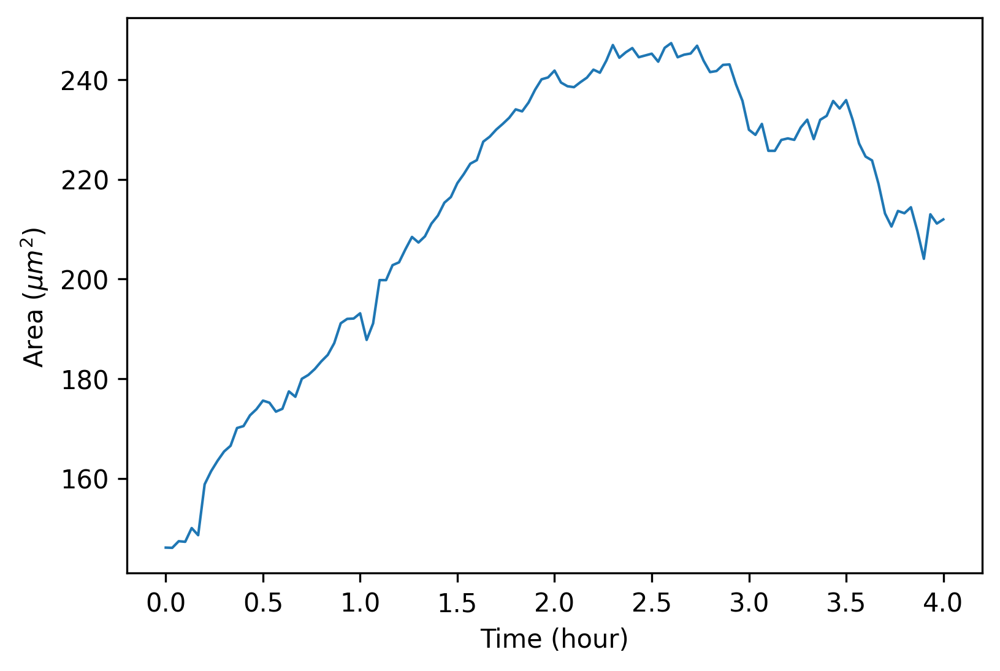

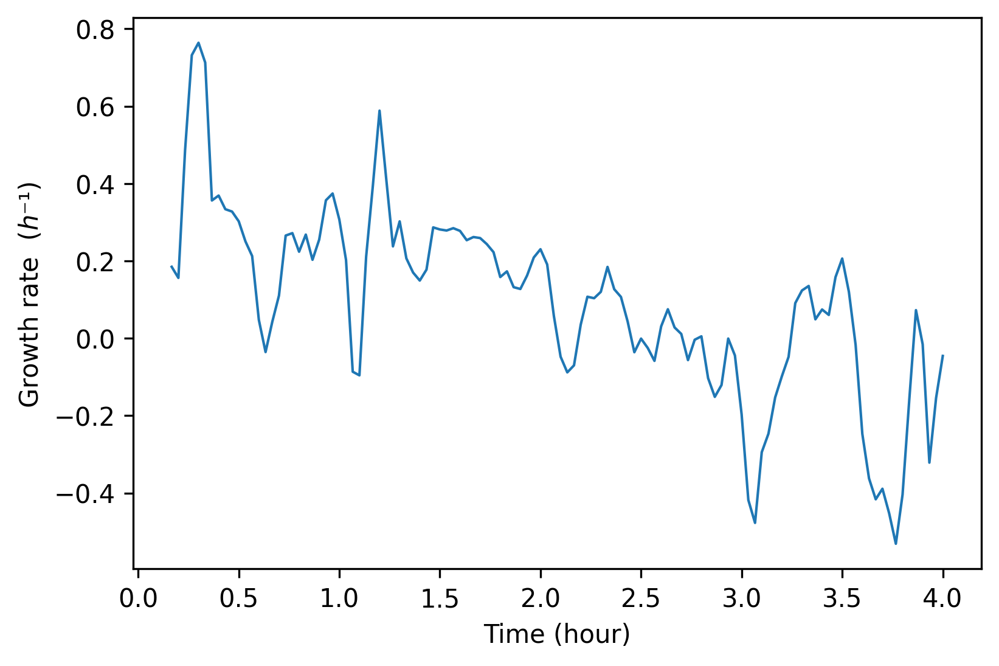

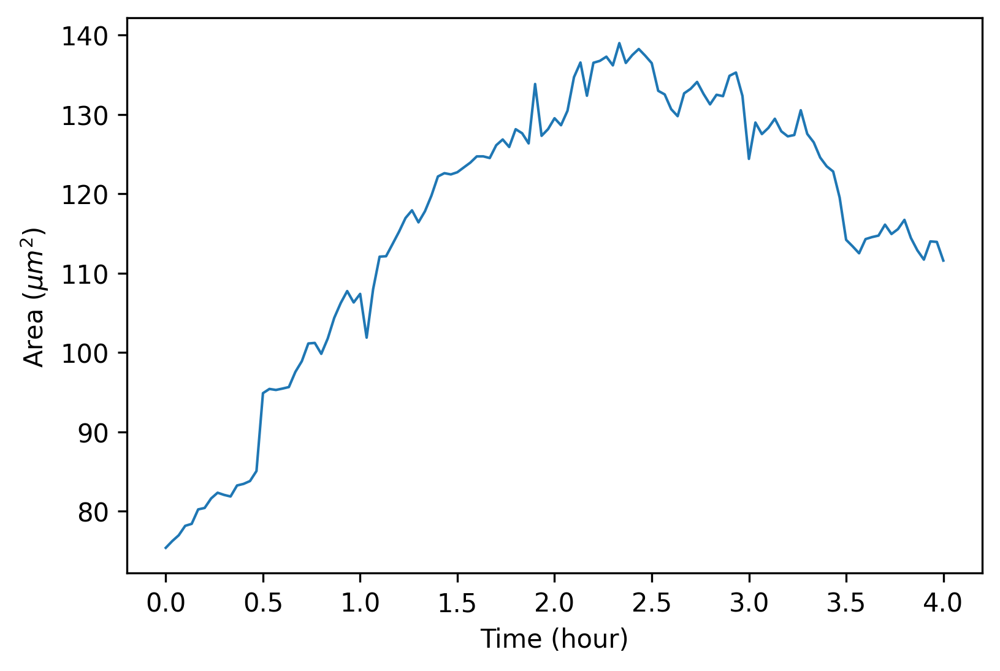

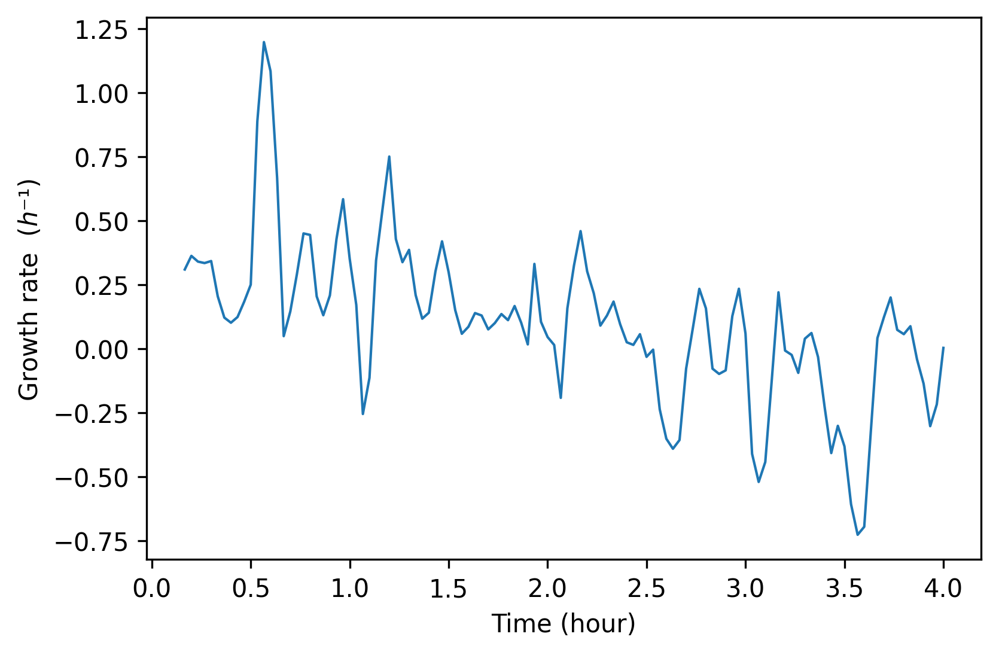

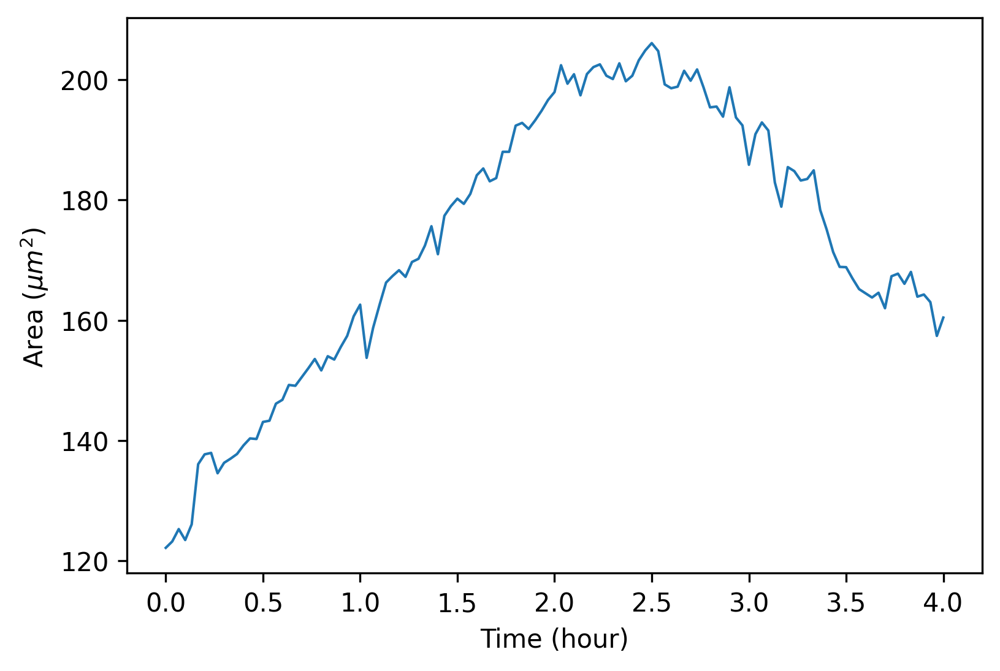

...

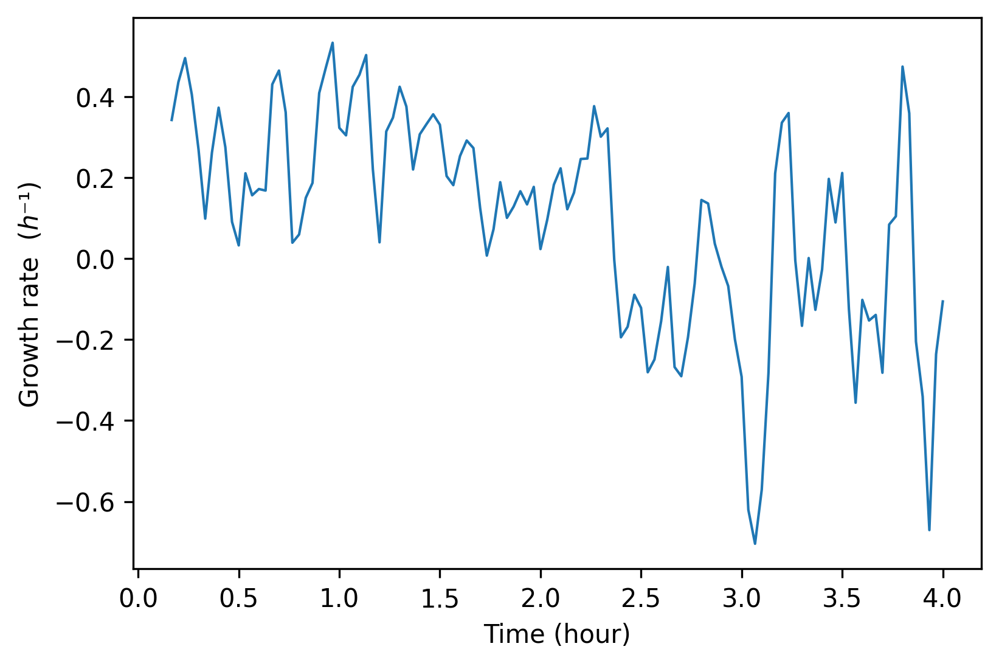

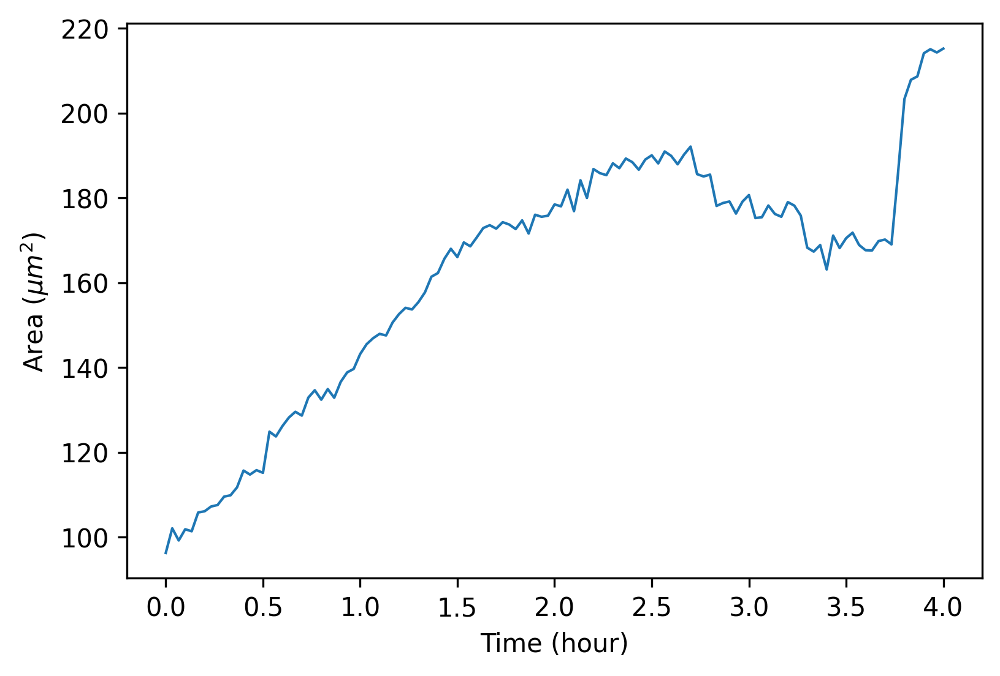

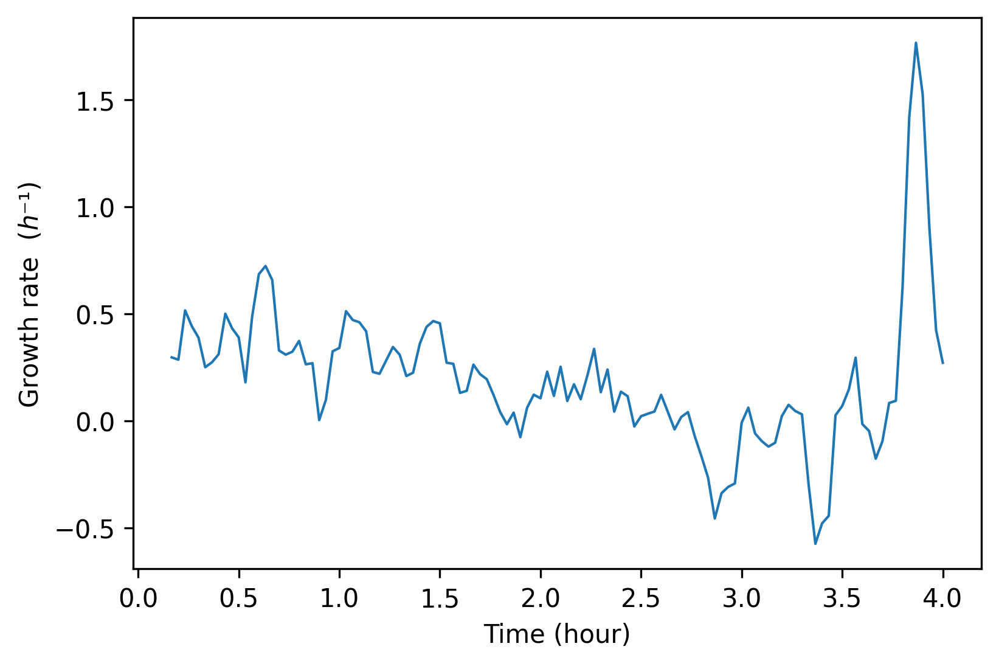

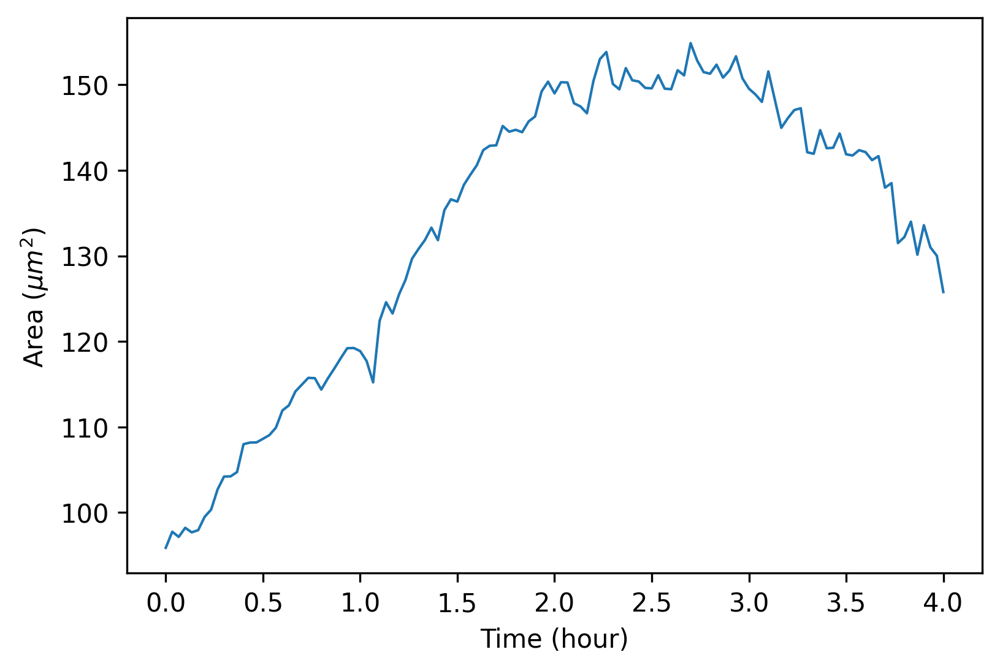

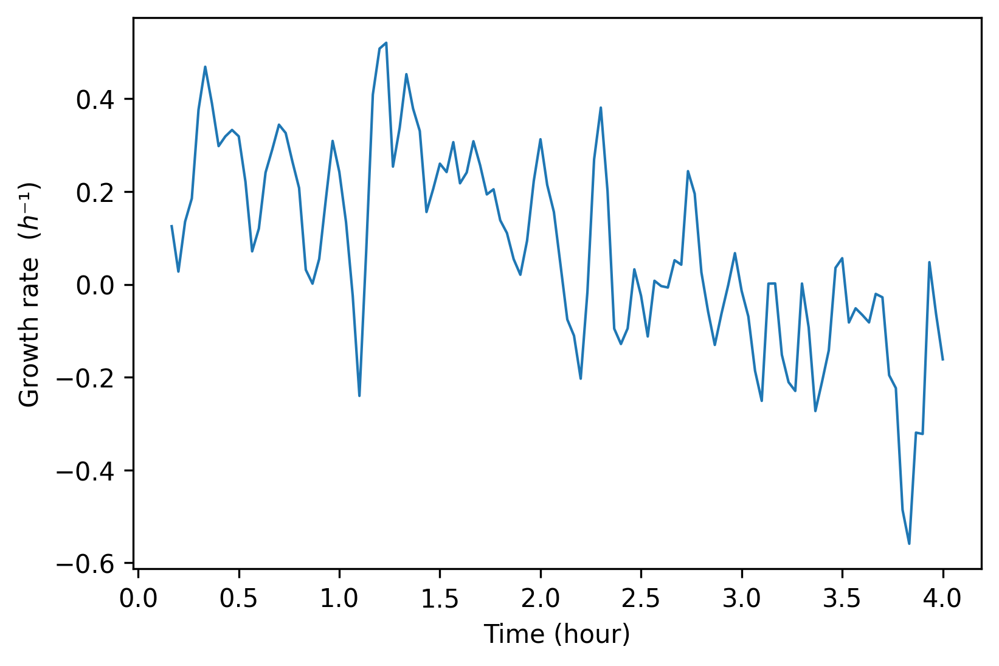

In [10]:
Save_Flow= False #@param {type:"boolean"}
save_flow=Save_Flow

print("Running segmentation on channel %s" %(segment_channel))
print("Using the model: ",model_choice)
if diameter is None:
  print("Diameter will be estimated from the image/s")
else:
  print(f"Cellpose will use a diameter of {diameter}")
print(f"Using a flow threshold of: {flow_threshold} and a cell probability threshold of: {cellprob_threshold}")

main_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/RIF10/" #@param {type:"string"}
positions = list(range(201,232))
list_position_dirs = []

for position in positions:
    if position < 100:
        dir_string = 'Pos0' + str(position)
    else:
        dir_string = 'Pos' + str(position)
    
    directory = os.path.join(main_dir, dir_string)
    list_position_dirs.append(directory)

phase_dir_name = 'PreprocessedPhase'
for position_directory in list_position_dirs:
    folder_list = os.listdir(position_directory)
    
    for folder_name in folder_list:
        if folder_name == phase_dir_name:
            input_dir = os.path.join(position_directory,folder_name)
            print(input_dir)
            
            save_dir = input_dir+"Masks/"
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            else:
                print("Existing Mask Directory found. Deleting it.")
                shutil.rmtree(save_dir)
            
            # r=root, d=directories, f = files
            files=[]
            for r, d, f in os.walk(input_dir):
                for fil in f:
                    if (image_format):
                        if fil.endswith(image_format):
                            files.append(os.path.join(r, fil))
                    else:
                        files.append(os.path.join(r, fil))
                break #only read the root directory; can change this to include levels
            
            imgs=[] #store all images
            files = sorted(files)
            #print(files)
            #Read images
            for f in files:
                im=skimage.io.imread(f)
                n_dim=len(im.shape) #shape of image
                dim=im.shape #dimensions of image
                channel=min(dim) #channel will be dimension with min value usually
                channel_position=dim.index(channel)
                #if no of dim is 3 and channel is first index, swap channel to last index
                if n_dim==3 and channel_position==0: 
                    #print(dim)
                    im=im.transpose(1,2,0)
                    dim=im.shape
                imgs.append(im)

            nimg = len(imgs)
            print("No of images loaded are: ", nimg)

            if (not os.path.exists(save_dir)):
                os.mkdir(save_dir)

            if save_flow:
                print("Saving Flow")
                flows_save_dir=save_dir+"flows"+os.sep
                print("Save Directory for flows is: ",flows_save_dir)
                if (not os.path.exists(flows_save_dir)):
                    os.mkdir(flows_save_dir)
            ##########################################################################
            pos_areas = np.zeros(len(imgs))
            ##########################################################################
            for img_idx, img in enumerate(imgs):
                file_name=os.path.splitext(os.path.basename(files[img_idx]))[0]
                print("\nSegmenting: ",file_name)
                mask, flow, style = model.eval(img, diameter=diameter, flow_threshold=flow_threshold, channels=None, 
                                         omni=omni, min_size=250, mask_threshold=0, cluster=True, affinity_seg=True, bsize=256, num_workers=16)
            ##########################################################################
                #get area value of the masks
                npoints = np.unique(mask, return_counts=True)[1][1:] #area in pixel numbers
                pos_areas[img_idx] = sum(npoints)
            ##########################################################################    
                #Output name for masks
                mask_output_name=save_dir+"MASK_"+file_name+".tif"
                #Save mask as 16-bit in case this has to be used for detecting than 255 objects
                mask=mask.astype(np.uint16)
                #Save flow as 8-bit
                skimage.io.imsave(mask_output_name,mask, check_contrast=False)
                if save_flow:
                  #Output name for flows
                  flow_output_name=flows_save_dir+"FLOWS_"+file_name+".tif"
                  #Save as 8-bit
                  flow_image=flow[0].astype(np.uint8)
                  skimage.io.imsave(flow_output_name,flow_image, check_contrast=False)
            
            #Save parameters used in Cellpose
            parameters_file=save_dir+"Cellpose_parameters_used.txt" 
            outFile=open(parameters_file, "w") 
            outFile.write("CELLPOSE PARAMETERS\n") 
            outFile.write("Model: "+model_choice+"\n") 
            if diameter == 0:
                diameter = "Automatically estimated by cellpose"
            outFile.write("Omni Flag: "+str(omni)+"\n") 
            outFile.write("Diameter: "+str(diameter)+"\n") 
            outFile.write("Flow Threshold: "+str(flow_threshold)+"\n") 
            outFile.write("Cell probability Threshold: "+str(cellprob_threshold)+"\n") 
            outFile.close() 
            #Write our areas data for each position
            with open(os.path.join(save_dir,"growth_areas.pickle"), "wb") as file:
                pickle.dump(pos_areas, file)

Collecting area growth and growth rate data for plotting of Msm NCTC8159 WT (RIF50)

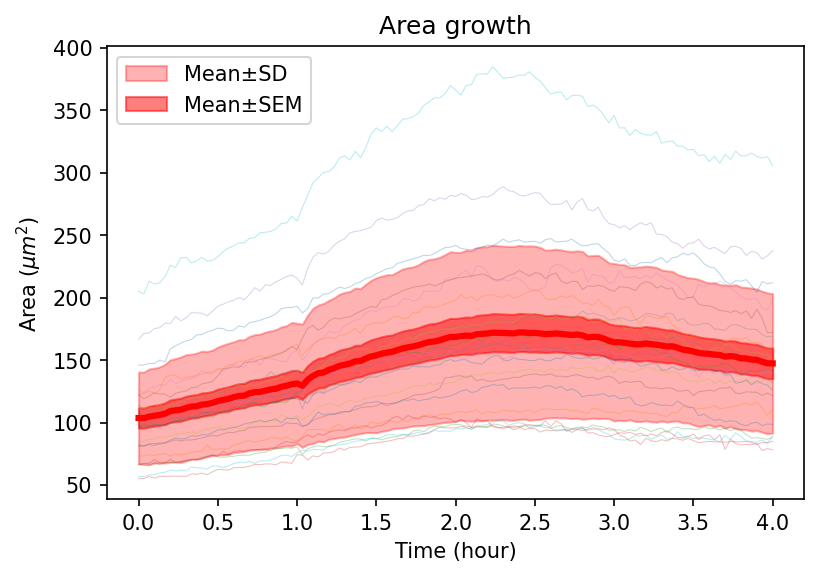

In [13]:
main_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/RIF10/" #@param {type:"string"}
all_positions = list(range(201,232))
empty_positions = [202,205,212,214,221,224,230,215,218,220]
positions = [pos for pos in all_positions if pos not in empty_positions]

list_position_dirs = []

for position in positions:
    if position < 100:
        dir_string = 'Pos0' + str(position)
    else:
        dir_string = 'Pos' + str(position)
    
    directory = os.path.join(main_dir, dir_string)
    list_position_dirs.append(directory)

phase_dir_name = 'PreprocessedPhaseMasks'
merged_areas_growth_data = []
merged_growth_rate_data = []

for position_directory in list_position_dirs:
    folder_list = os.listdir(position_directory)
    
    for folder_name in folder_list:
        if folder_name == phase_dir_name:
            input_dir = os.path.join(position_directory,folder_name)
            #print(input_dir)
            file_list = os.listdir(input_dir)
            
            for file_name in file_list:
                if file_name.endswith('growth_areas.pickle'):
                    areas_file_path = os.path.join(input_dir, file_name)

                    with open(areas_file_path, 'rb') as f:
                        areas_growth_data = pickle.load(f)

                        merged_areas_growth_data.append(areas_growth_data)

                if file_name.endswith('growth_rate.pickle'):
                    growth_rate_file_path = os.path.join(input_dir, file_name)

                    with open(growth_rate_file_path, 'rb') as f:
                        growth_rate_data = pickle.load(f)

                        merged_growth_rate_data.append(growth_rate_data)

#Stack merged area growth to calculate mean, standard deviation and standard error of mean
stacked_merged_areas_growth_data = np.vstack(merged_areas_growth_data)

with open(os.path.join(main_dir,"stacked_merged_areas_growth_data.pickle"), "wb") as file:
    pickle.dump(stacked_merged_areas_growth_data, file)
        
areas_column_means = np.mean(stacked_merged_areas_growth_data, axis=0)
areas_column_std_dev = np.std(stacked_merged_areas_growth_data, axis=0, ddof=1)
areas_column_std_err = stats.sem(stacked_merged_areas_growth_data, axis=0, ddof=1)

#Extract the number of positions and of frames
num_pos, num_frame = stacked_merged_areas_growth_data.shape

time_plot = [time*(2/60) for time in range(0, num_frame)] #the interval time between two frames is 2 min,
corrected_areas_plot = stacked_merged_areas_growth_data*(0.0733**2) #the pixel size is 73.3 nm at 150x magnification in Nikon6
corrected_areas_column_means = areas_column_means*(0.0733**2)
corrected_areas_column_std_dev = areas_column_std_dev*(0.0733**2)
corrected_areas_column_std_err = areas_column_std_err*(0.0733**2)

# Create a plot
plt.figure(facecolor='white')  # Optional: Set the figure size
plt.plot(time_plot, corrected_areas_plot.T, lw = 0.5, alpha=0.3)  # Transpose the data to plot columns as separate lines
plt.plot(time_plot, corrected_areas_column_means, lw = 3, color = 'red')
plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_dev, 
                 corrected_areas_column_means + corrected_areas_column_std_dev, 
                 label='Mean±SD', alpha=0.3, color = 'red')
plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_err, 
                 corrected_areas_column_means + corrected_areas_column_std_err, 
                 label='Mean±SEM', alpha=0.5, color = 'red')
plt.xlabel('Time (hour)')
plt.ylabel('Area'+ r' ($\mu m^2$) ')
plt.title('Area growth')
plt.legend()
plt.show()

GROWTH RATE NORMALIZATION

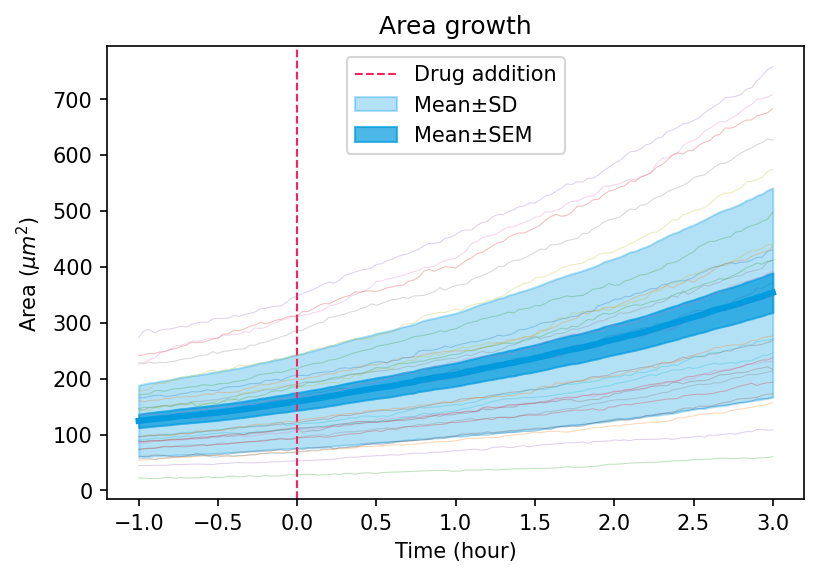

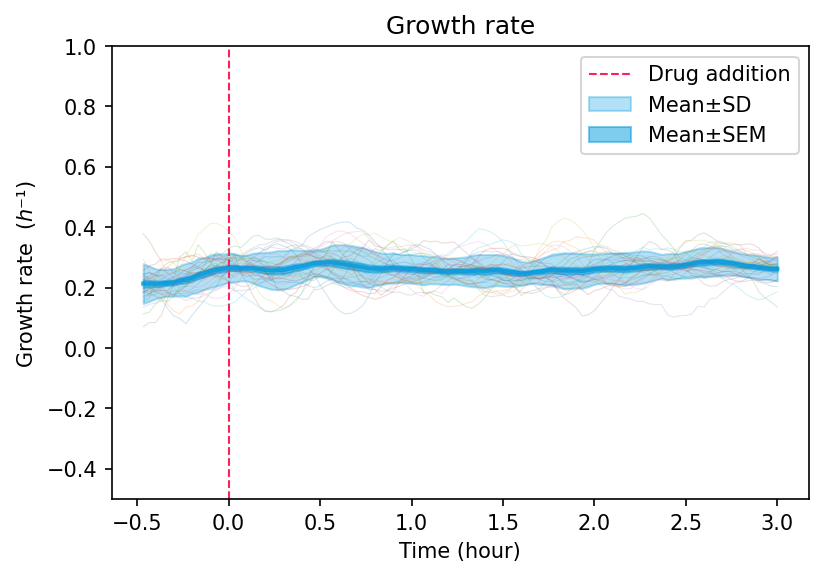

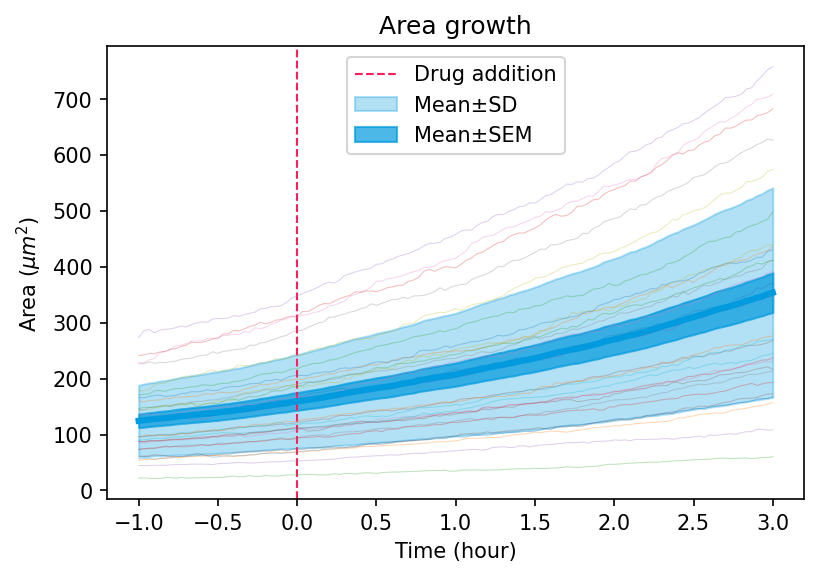

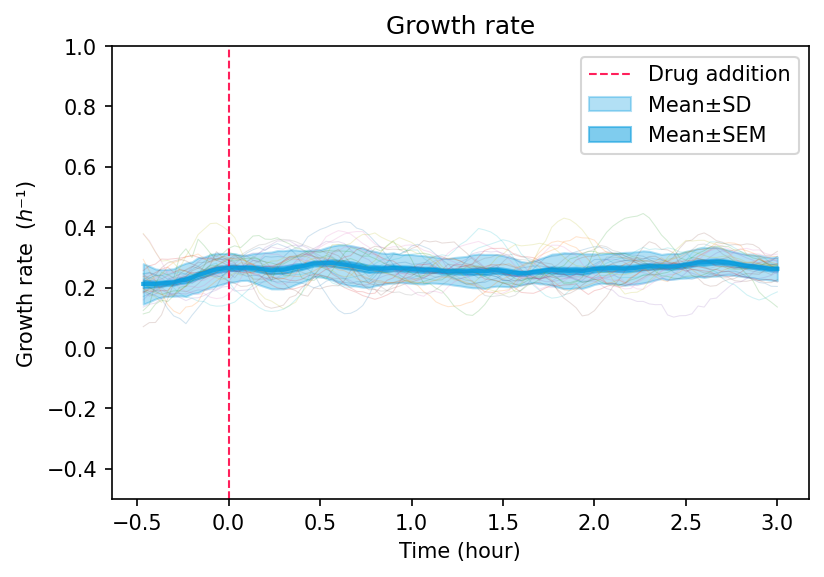

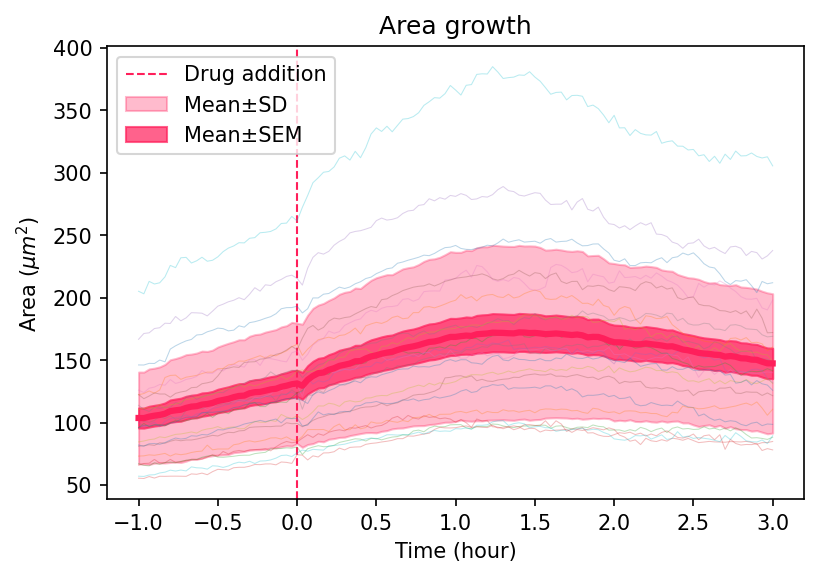

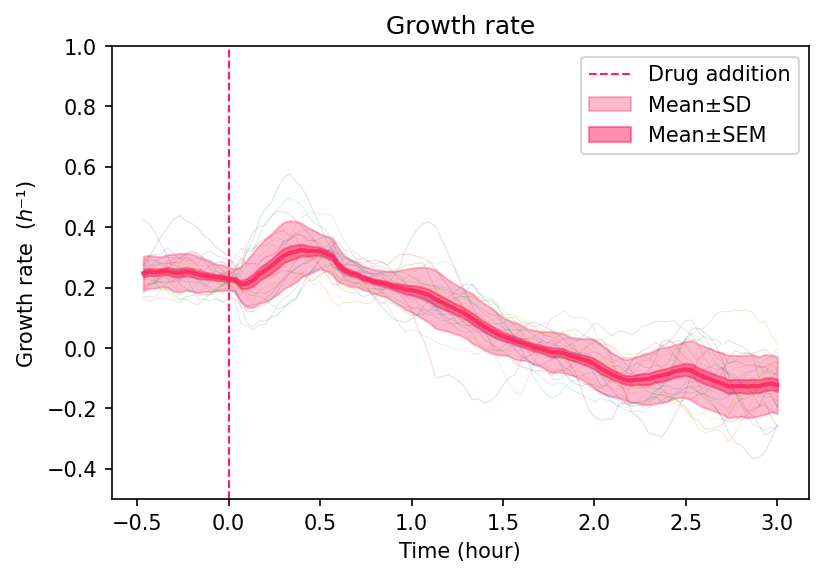

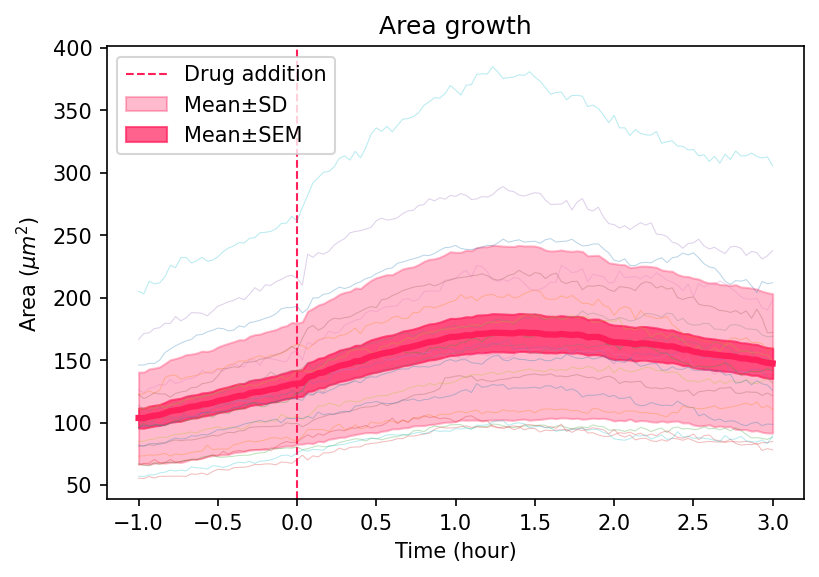

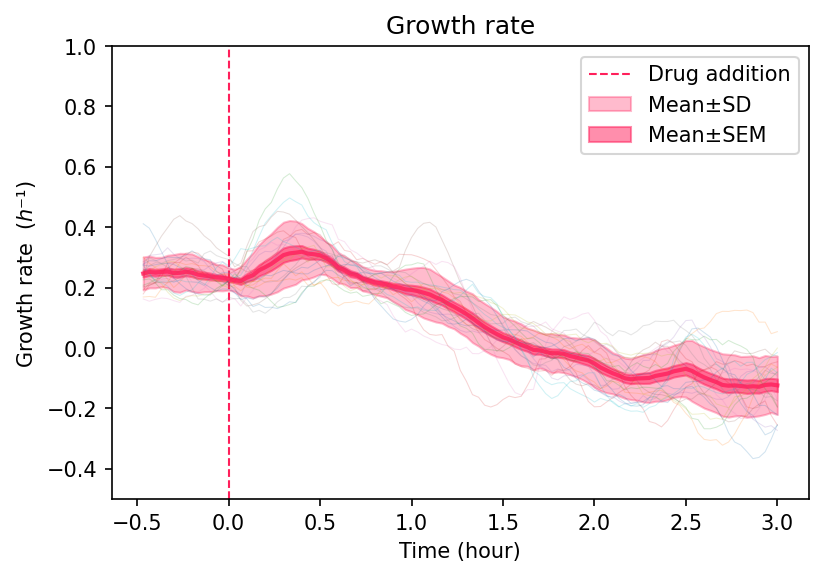

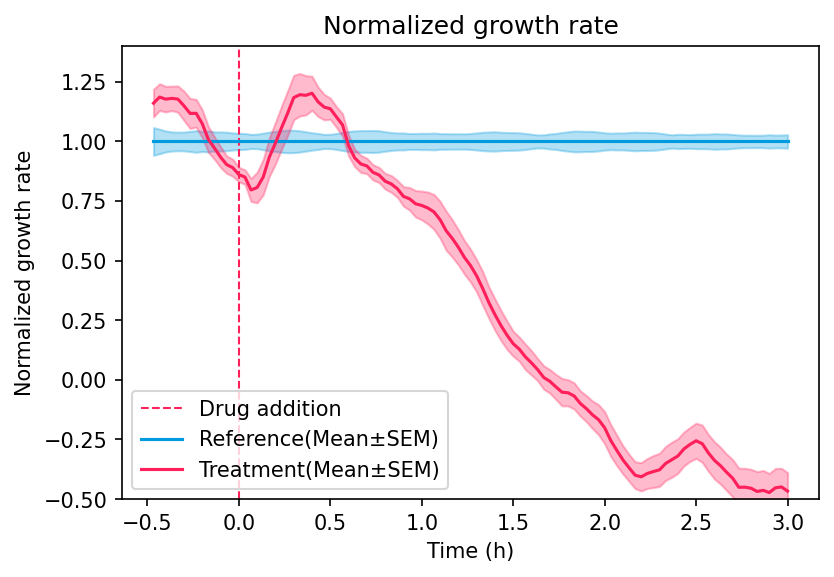

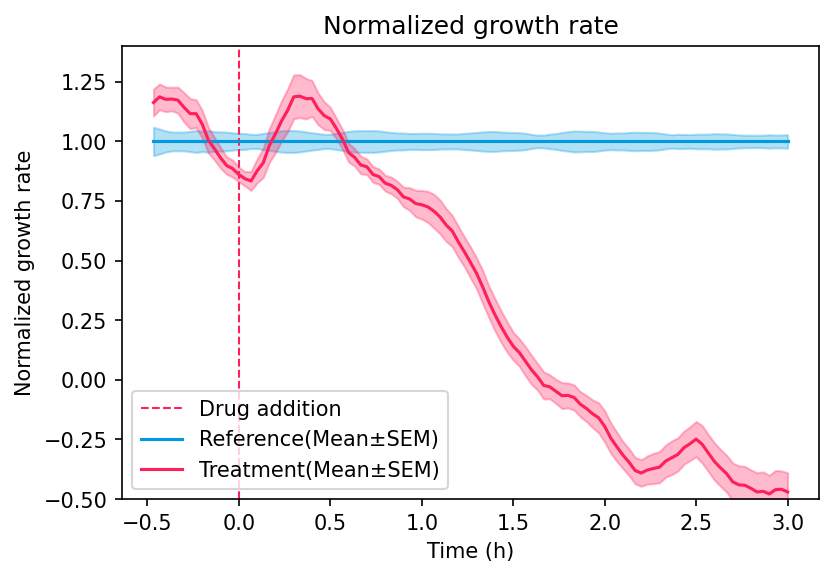

In [3]:
ref_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/REF/"
treat_dir = "/home/bmtran/Desktop/Mycobacteria/analysis/EXP-23-BZ3143/EXP-23-BZ3167/RIF10/"

def exp_growth_fit(x, a, b):
	return a * np.exp(b * x)

def get_areas_data(input_dir):
    file_list = os.listdir(input_dir)

    for file_name in file_list:
        if file_name.endswith('stacked_merged_areas_growth_data.pickle'):
            areas_file_path = os.path.join(input_dir, file_name)

    with open(areas_file_path, 'rb') as f:
        stacked_merged_areas_growth_data = pickle.load(f)
    
    return stacked_merged_areas_growth_data

def fit_exponential(data,rolling_number,divisor):
    fitted_chunk = int(rolling_number/divisor)
    # Define the exponential function
    def exponential(x, a, b):
        return a * np.exp(b * x)
    
    # Define a function to check if a value fits well with the fitted exponential function
    def is_good_fit(x, y, a, b, threshold=0.05):
        fitted_value = exponential(x, a, b)
        return abs((y - fitted_value) / y) <= threshold
    
    result = []

    # Loop over the data in chunks of 18
    for i in range(0, len(data)-1, fitted_chunk):
        chunk = data[i:i+fitted_chunk]
        # Fit the exponential function to the chunk
        try:
            popt, _ = curve_fit(exponential, range(len(chunk)), chunk, maxfev=5000)
        except RuntimeError:
            # Fitting failed, just append the chunk as is
            result.extend(chunk)
            continue

        # Check if each value in the chunk fits well with the fitted function
        for j, value in enumerate(chunk):
            if not is_good_fit(j, value, *popt):
                # Replace the value with the fitted value
                chunk[j] = exponential(j, *popt)
        result.extend(chunk)

    return result

def calculate_growth_rate_rolling(rolling_number, interval_time, area_data):
    growth_rate_rollings = []
    for i in range(rolling_number,len(area_data)):
        if i >= rolling_number: 
            time_rolling = [time for time in range(i-rolling_number,i)] 
            area_rolling = [value for value in area_data[i-rolling_number:i]]  
            p0 = [1, 0.0005]  # Initial parameter estimates [a, b]                                   
            popt, _ = curve_fit(exp_growth_fit, time_rolling, area_rolling, p0=p0)  #return popt[0] = a and popt[1] = b
            growth_rate_rollings.append(popt[1]/interval_time*60)
    
    return growth_rate_rollings

def find_means_std_sem(data):
    stacked_data = np.vstack(data)
    stacked_data_means = np.mean(stacked_data, axis=0)
    stacked_data_std_dev = np.std(stacked_data, axis=0, ddof=1)
    stacked_data_std_err = stats.sem(stacked_data, axis=0, ddof=1)
    
    return stacked_data_means, stacked_data_std_dev, stacked_data_std_err

def plot_area_growth(corrected_areas_plot, interval_time, num_frame, corrected_areas_column_means, corrected_areas_column_std_dev, corrected_areas_column_std_err, color):
    time_plot = [time*(interval_time/60)-1 for time in range(0, num_frame)]  #the interval time between two frames is 10 min,
   
    # Create a plot
    plt.figure(facecolor='white')  # Optional: Set the figure size
    # Add a vertical line at x=0
    plt.axvline(x=0, color='#FF1F5B', linestyle='--', lw=1, label='Drug addition') ##e64b35
    plt.plot(time_plot, corrected_areas_plot.T, lw = 0.5, alpha=0.3)  # Transpose the data to plot columns as separate lines
    plt.plot(time_plot, corrected_areas_column_means, lw = 3, color = color)
    plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_dev, 
                     corrected_areas_column_means + corrected_areas_column_std_dev, 
                     label='Mean±SD', alpha=0.3, color = color)
    plt.fill_between(time_plot, corrected_areas_column_means - corrected_areas_column_std_err, 
                     corrected_areas_column_means + corrected_areas_column_std_err, 
                     label='Mean±SEM', alpha=0.7, color = color)
    plt.xlabel('Time (hour)')
    plt.ylabel('Area'+ r' ($\mu m^2$) ')
    plt.title('Area growth')
    plt.legend()
    
def plot_growth_curve(stacked_growth_data, interval_time, rolling_number, num_frame, growth_mean, growth_std, growth_sem, color):
    time_plot_growth = [time*(interval_time/60)-1 for time in range(0, num_frame+rolling_number)] 

    # Create a plot
    plt.figure(facecolor='white')  # Optional: Set the figure size
    # Add a vertical line at x=0
    plt.axvline(x=0, color='#FF1F5B', linestyle='--', lw=1, label='Drug addition')
    
    plt.plot(time_plot_growth[rolling_number:],stacked_growth_data.T, lw = 0.5, alpha=0.2)  # Transpose the data to plot columns as separate lines
    plt.plot(time_plot_growth[rolling_number:],growth_mean, lw = 2, alpha=0.8, color = color)
    plt.fill_between(time_plot_growth[rolling_number:], growth_mean - growth_std, growth_mean + growth_std, label='Mean±SD', alpha=0.3, color = color)
    plt.fill_between(time_plot_growth[rolling_number:], growth_mean - growth_sem, growth_mean + growth_sem, label='Mean±SEM', alpha=0.5, color = color)
    plt.xlabel('Time (hour)')
    plt.ylabel('Growth rate '+ r' ($h⁻¹$) ')
    plt.title('Growth rate')
    plt.ylim(-0.5,1)
    plt.legend()  

def normalize_lists(list_a, list_b):
    # Check if both lists have the same length
    if len(list_a) != len(list_b):
        raise ValueError("Lists must have the same length")

    # Normalize values
    normalized_result = [a / b for a, b in zip(list_a, list_b)]

    return normalized_result

#Experiment parameters
rolling_number = 16 #number of data points for fitting M. smegmatis (2 mins intervals for 4 hours) (rolling of 16 points = 30 min)
interval_time = 2 #interval between frames in minutes
pixel_area = 0.0733**2 #the pixel size is 73.3 nm at 100x*1.5x magnification in Nikon6

#####################################################################################
#reference
ref_areas_data = get_areas_data(ref_dir)
ref_areas_data = ref_areas_data*pixel_area

# calculate and plot area
ref_areas_means, ref_areas_std, ref_areas_sem = find_means_std_sem(ref_areas_data)
num_pos_areas, num_frame_areas = ref_areas_data.shape
plot_area_growth(ref_areas_data, interval_time, num_frame_areas, ref_areas_means, ref_areas_std, ref_areas_sem, color='#009ADE') ##0D4A70
plt.savefig(os.path.join(ref_dir,"EXP-23-BZ3167_REFERENCE-Area.svg"))
plt.show()

# calculate and plot growth rate
ref_growth_rates = []
for pos_area in ref_areas_data:
    ref_pos_growth_rate = calculate_growth_rate_rolling(rolling_number, interval_time, pos_area)
    ref_growth_rates.append(ref_pos_growth_rate)

ref_growth_means, ref_growth_std, ref_growth_sem = find_means_std_sem(ref_growth_rates)

stacked_ref_growth_rates = np.vstack(ref_growth_rates)
num_pos, num_frame = stacked_ref_growth_rates.shape
plot_growth_curve(stacked_ref_growth_rates, interval_time, rolling_number, num_frame, ref_growth_means, ref_growth_std, ref_growth_sem, color = '#009ADE')
plt.savefig(os.path.join(ref_dir,"EXP-23-BZ3167_REFERENCE-Growth_rate.svg"))
plt.show()

#calculate and plot area (fit)
ref_fit_areas = []
for pos_area in ref_areas_data:
    ref_pos_fit_area = fit_exponential(pos_area, rolling_number, 2)
    ref_pos_fit_area = fit_exponential(pos_area, rolling_number, 1)
    ref_pos_fit_area = fit_exponential(pos_area, rolling_number, 0.5)
    ref_fit_areas.append(ref_pos_fit_area)
    
ref_fit_areas_means, ref_fit_areas_std, ref_fit_areas_sem = find_means_std_sem(ref_fit_areas)
stacked_fit_areas = np.vstack(ref_fit_areas)
num_pos_fit_areas, num_frame_fit_areas = stacked_fit_areas.shape
plot_area_growth(stacked_fit_areas, interval_time, num_frame_fit_areas, ref_fit_areas_means, ref_fit_areas_std, ref_fit_areas_sem, color='#009ADE')
plt.savefig(os.path.join(ref_dir,"EXP-23-BZ3167_REFERENCE-Area-fit.svg"))
plt.show()


#calculate and plot growth rate
ref_fit_growth_rates = []
for pos_area_fit in stacked_fit_areas:
    ref_pos_fit_growth_rate = calculate_growth_rate_rolling(rolling_number, interval_time, pos_area_fit)
    ref_fit_growth_rates.append(ref_pos_fit_growth_rate)

ref_fit_growth_means, ref_fit_growth_std, ref_fit_growth_sem = find_means_std_sem(ref_fit_growth_rates)

stacked_ref_fit_growth_rates = np.vstack(ref_fit_growth_rates)
num_pos_fit, num_frame_fit = stacked_ref_fit_growth_rates.shape

plot_growth_curve(stacked_ref_fit_growth_rates, interval_time, rolling_number, num_frame_fit, ref_fit_growth_means, ref_fit_growth_std, ref_fit_growth_sem, color = '#009ADE')
plt.savefig(os.path.join(ref_dir,"EXP-23-BZ3167_REFERENCE-Growth-rate-fit.svg"))
plt.show()

#####################################################################################
#treatment
treat_areas_data = get_areas_data(treat_dir)
treat_areas_data = treat_areas_data*pixel_area

#calculate and plot area
treat_areas_means, treat_areas_std, treat_areas_sem = find_means_std_sem(treat_areas_data)
num_pos_areas, num_frame_areas = treat_areas_data.shape

plot_area_growth(treat_areas_data, interval_time, num_frame_areas, treat_areas_means, treat_areas_std, treat_areas_sem, color='#FF1F5B')
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_TREAT-Area.svg"))
plt.show()

#Calculate and plot growth rates
treat_growth_rates = []
for pos_area in treat_areas_data:
    treat_pos_growth_rate = calculate_growth_rate_rolling(rolling_number, interval_time, pos_area)
    treat_growth_rates.append(treat_pos_growth_rate)

treat_growth_means, treat_growth_std, treat_growth_sem = find_means_std_sem(treat_growth_rates)

stacked_treat_growth_rates = np.vstack(treat_growth_rates)
num_pos, num_frame = stacked_treat_growth_rates.shape

plot_growth_curve(stacked_treat_growth_rates, interval_time, rolling_number, num_frame, treat_growth_means, treat_growth_std, treat_growth_sem, color = '#FF1F5B')
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_TREATMENT-Growth-rate.svg"))
plt.show()

#Calculate and plot growth rates (from fitted area data)
treat_fit_areas = []
for pos_area in treat_areas_data:
    treat_pos_fit_area = fit_exponential(pos_area, rolling_number, 2)
    treat_pos_fit_area = fit_exponential(pos_area, rolling_number, 1)
    treat_pos_fit_area = fit_exponential(pos_area, rolling_number, 0.5)
    treat_fit_areas.append(treat_pos_fit_area)
    
treat_fit_areas_means, treat_fit_areas_std, treat_fit_areas_sem = find_means_std_sem(treat_fit_areas)
treat_stacked_fit_areas = np.vstack(treat_fit_areas)
num_pos_fit_areas, num_frame_fit_areas = treat_stacked_fit_areas.shape
plot_area_growth(treat_stacked_fit_areas, interval_time, num_frame_fit_areas, treat_fit_areas_means, treat_fit_areas_std, treat_fit_areas_sem, color='#FF1F5B')
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_TREAT-Area-fit.svg"))
plt.show()

#calculate and plot growth rate
treat_fit_growth_rates = []
for pos_area_fit in treat_stacked_fit_areas:
    treat_pos_fit_growth_rate = calculate_growth_rate_rolling(rolling_number, interval_time, pos_area_fit)
    treat_fit_growth_rates.append(treat_pos_fit_growth_rate)

treat_fit_growth_means, treat_fit_growth_std, treat_fit_growth_sem = find_means_std_sem(treat_fit_growth_rates)

stacked_treat_fit_growth_rates = np.vstack(treat_fit_growth_rates)
num_pos_fit, num_frame_fit = stacked_treat_fit_growth_rates.shape

plot_growth_curve(stacked_treat_fit_growth_rates, interval_time, rolling_number, num_frame_fit, treat_fit_growth_means, treat_fit_growth_std, treat_fit_growth_sem, color = '#FF1F5B')
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_TREATMENT-Growth-rate-fit.svg"))
plt.show()

#####################################################################################
#normalization of reference means, standard deviations, SEMs to the reference means
normalized_ref_ref_means = normalize_lists(ref_growth_means,ref_growth_means)
normalized_ref_ref_means = np.array(normalized_ref_ref_means)

normalized_ref_ref_std = normalize_lists(ref_growth_std,ref_growth_means)
normalized_ref_ref_std = np.array(normalized_ref_ref_std)

normalized_ref_ref_sem = normalize_lists(ref_growth_sem,ref_growth_means)
normalized_ref_ref_sem = np.array(normalized_ref_ref_sem)

#normalization of treatment means, standard deviations, SEMs to the reference means
normalized_treat_ref_means = normalize_lists(treat_growth_means,ref_growth_means)
normalized_treat_ref_means = np.array(normalized_treat_ref_means)

normalized_treat_ref_std = normalize_lists(treat_growth_std,ref_growth_means)
normalized_treat_ref_std = np.array(normalized_treat_ref_std)

normalized_treat_ref_sem = normalize_lists(treat_growth_sem,ref_growth_means)
normalized_treat_ref_sem = np.array(normalized_treat_ref_sem)

time_plot_growth = [time*(interval_time/60)-1 for time in range(0, num_frame+rolling_number)] 

plt.figure(facecolor='white')
# Add a vertical line at x=0
plt.axvline(x=0, color='#FF1F5B', linestyle='--', lw=1, label='Drug addition')
plt.plot(time_plot_growth[rolling_number:], normalized_ref_ref_means, label='Reference(Mean±SEM)', color = '#009ADE')
plt.fill_between(time_plot_growth[rolling_number:], normalized_ref_ref_means - normalized_ref_ref_sem, normalized_ref_ref_means + normalized_ref_ref_sem, alpha=0.3, color = '#009ADE')
plt.plot(time_plot_growth[rolling_number:], normalized_treat_ref_means, label='Treatment(Mean±SEM)', color = '#FF1F5B')
plt.fill_between(time_plot_growth[rolling_number:], normalized_treat_ref_means - normalized_treat_ref_sem, normalized_treat_ref_means + normalized_treat_ref_sem, alpha=0.3, color = '#FF1F5B')
plt.xlabel('Time (h)')
plt.ylabel('Normalized growth rate')
plt.legend()
plt.title('Normalized growth rate')
plt.ylim(-0.5,1.4)
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_NORMALIZED-Growth_rate.svg"))
plt.show()

#####################################################################################
#normalization of reference means, standard deviations, SEMs to the reference means
normalized_fit_ref_ref_means = normalize_lists(ref_fit_growth_means,ref_fit_growth_means)
normalized_fit_ref_ref_means = np.array(normalized_fit_ref_ref_means)

normalized_fit_ref_ref_std = normalize_lists(ref_fit_growth_std,ref_fit_growth_means)
normalized_fit_ref_ref_std = np.array(normalized_fit_ref_ref_std)

normalized_fit_ref_ref_sem = normalize_lists(ref_fit_growth_sem,ref_fit_growth_means)
normalized_fit_ref_ref_sem = np.array(normalized_fit_ref_ref_sem)

#normalization of treatment means, standard deviations, SEMs to the reference means
normalized_fit_treat_ref_means = normalize_lists(treat_fit_growth_means,ref_fit_growth_means)
normalized_fit_treat_ref_means = np.array(normalized_fit_treat_ref_means)

normalized_fit_treat_ref_std = normalize_lists(treat_fit_growth_std,ref_fit_growth_means)
normalized_fit_treat_ref_std = np.array(normalized_fit_treat_ref_std)

normalized_fit_treat_ref_sem = normalize_lists(treat_fit_growth_sem,ref_fit_growth_means)
normalized_fit_treat_ref_sem = np.array(normalized_fit_treat_ref_sem)

time_plot_growth = [time*(interval_time/60)-1 for time in range(0, num_frame+rolling_number)] 

plt.figure(facecolor='white')
# Add a vertical line at x=0
plt.axvline(x=0, color='#FF1F5B', linestyle='--', lw=1, label='Drug addition')
plt.plot(time_plot_growth[rolling_number:], normalized_fit_ref_ref_means, label='Reference(Mean±SEM)', color = '#009ADE')
plt.fill_between(time_plot_growth[rolling_number:], normalized_fit_ref_ref_means - normalized_fit_ref_ref_sem, normalized_fit_ref_ref_means + normalized_fit_ref_ref_sem, alpha=0.3, color = '#009ADE')
plt.plot(time_plot_growth[rolling_number:], normalized_fit_treat_ref_means, label='Treatment(Mean±SEM)', color = '#FF1F5B')
plt.fill_between(time_plot_growth[rolling_number:], normalized_fit_treat_ref_means - normalized_fit_treat_ref_sem, normalized_fit_treat_ref_means + normalized_fit_treat_ref_sem, alpha=0.3, color = '#FF1F5B')
plt.xlabel('Time (h)')
plt.ylabel('Normalized growth rate')
plt.legend()
plt.title('Normalized growth rate')
plt.ylim(-0.5,1.4)
plt.savefig(os.path.join(treat_dir,"EXP-23-BZ3167_NORMALIZED-Growth-rate-fit.svg"))
plt.show()

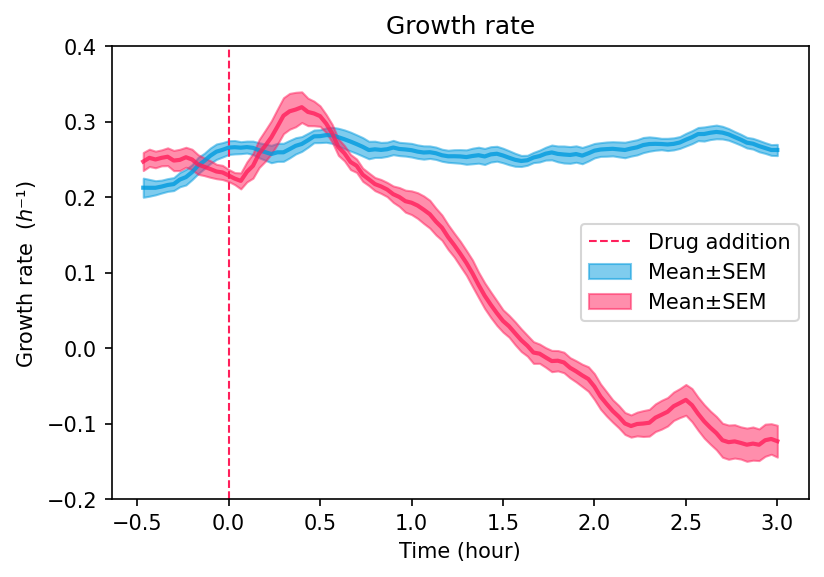

In [6]:
def plot_growth_curve_two(stacked_growth_data, interval_time, rolling_number, num_frame, growth_mean, growth_std, growth_sem, stacked_growth_data2, growth_mean2, growth_std2, growth_sem2, color, color2):
    time_plot_growth = [time*(interval_time/60)-1 for time in range(0, num_frame+rolling_number)] 

    # Create a plot
    plt.figure(facecolor='white')  # Optional: Set the figure size
    # Add a vertical line at x=0
    plt.axvline(x=0, color='#FF1F5B', linestyle='--', lw=1, label='Drug addition')

    plt.plot(time_plot_growth[rolling_number:],growth_mean, lw = 2, alpha=0.8, color = color)
    plt.fill_between(time_plot_growth[rolling_number:], growth_mean - growth_sem, growth_mean + growth_sem, label='Mean±SEM', alpha=0.5, color = color)
    
    plt.plot(time_plot_growth[rolling_number:],growth_mean2, lw = 2, alpha=0.8, color = color2)
    plt.fill_between(time_plot_growth[rolling_number:], growth_mean2 - growth_sem2, growth_mean2 + growth_sem2, label='Mean±SEM', alpha=0.5, color = color2)
    
    plt.xlabel('Time (hour)')
    plt.ylabel('Growth rate '+ r' ($h⁻¹$) ')
    plt.title('Growth rate')
    plt.ylim(-0.2,0.4)
    plt.legend()   

#####################################################################################
#Ploting growth curve of both reference and treatment in the same graph
plot_growth_curve_two(stacked_ref_fit_growth_rates, interval_time, rolling_number, num_frame_fit, ref_fit_growth_means, ref_fit_growth_std, ref_fit_growth_sem, 
                      stacked_treat_fit_growth_rates, treat_fit_growth_means, treat_fit_growth_std, treat_fit_growth_sem, color = '#009ADE', color2 = '#FF1F5B')
plt.savefig(os.path.join(treat_dir,"EXP-24-CB5615_TREATMENT and REFERENCE-Growth-rate-fit.svg"))
plt.show()